# 1 Setting up

## 1.1 Libraries

In [106]:
# Data manipulation libraries
import pandas as pd
import numpy as np

# Visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns

# Machine learning
from sklearn import datasets
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
import umap.plot
import gower
import hdbscan
from multi_mst.noisy_mst import NoisyMST

## 1.2 Importing dataset

In [107]:
data = pd.read_csv('Preprocessed_DM_xx.csv', index_col=0)


/var/folders/dr/0j9y6x3n3nv4s_4ssbwb3g240000gn/T/ipykernel_1407/2278545661.py:1: DtypeWarning: Columns (13,15) have mixed types. Specify dtype option on import or set low_memory=False.
  data = pd.read_csv('Preprocessed_DM_xx.csv', index_col=0)


In [108]:
# Display the first few rows of the dataset
data.head(10)

,Current.age,Sex,Currently.has.asthma,Currently.has.thyroid.disorder,Currently.has.heart.disease,Currently.has.cancer,Suffers.from.TB,SBP_status,First.SYSTOLIC.reading,First.DIASTOLIC.reading,...,Has.motorcycle.scooter,Has.car.truck,Type.of.cooking.fuel,Household.structure,Owns.livestock..herds.or.farm.animals,Source.of.drinking.water,Time.to.get.to.water.source..minutes.,Glucose.level,DM_status,DM_history
1,47,1,0.0,0.0,0.0,0.0,0,0,112.0,74.0,...,1,1,3,0,0,3,0,78.0,0,0.0
2,46,1,1.0,1.0,0.0,0.0,0,0,120.0,86.0,...,1,0,3,1,0,3,0,97.0,0,0.0
3,42,0,0.0,0.0,0.0,0.0,0,0,128.0,74.0,...,0,0,4,0,0,3,0,138.0,0,0.0
4,41,1,0.0,0.0,0.0,0.0,0,0,117.0,82.0,...,0,0,4,0,0,3,0,128.0,1,1.0
5,51,0,0.0,0.0,0.0,0.0,0,0,124.0,88.0,...,1,1,3,1,0,3,0,102.0,0,0.0
6,42,1,0.0,0.0,0.0,0.0,0,0,112.0,76.0,...,1,1,3,1,0,3,0,106.0,0,0.0
7,20,0,0.0,0.0,0.0,0.0,0,0,113.0,60.0,...,1,1,3,1,0,3,0,96.0,0,0.0
8,17,0,0.0,0.0,0.0,0.0,0,0,115.0,67.0,...,1,1,3,1,0,3,0,96.0,0,0.0
11,22,1,0.0,0.0,0.0,0.0,0,0,121.0,72.0,...,1,0,3,0,0,3,0,100.0,0,0.0
12,27,0,0.0,0.0,0.0,0.0,0,0,118.0,92.0,...,1,0,3,0,0,3,0,92.0,0,0.0


In [109]:
# Print basic information about the dataset
print(data.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 730846 entries, 1 to 810971
Data columns (total 53 columns):
 #   Column                                              Non-Null Count   Dtype  
---  ------                                              --------------   -----  
 0   Current.age                                         730846 non-null  int64  
 1   Sex                                                 730846 non-null  int64  
 2   Currently.has.asthma                                730846 non-null  float64
 3   Currently.has.thyroid.disorder                      730846 non-null  float64
 4   Currently.has.heart.disease                         730846 non-null  float64
 5   Currently.has.cancer                                730846 non-null  float64
 6   Suffers.from.TB                                     730846 non-null  int64  
 7   SBP_status                                          730846 non-null  int64  
 8   First.SYSTOLIC.reading                              730846 non-n

In [110]:
# Check for missing values
print(data.isnull().sum())

Current.age                                           0
Sex                                                   0
Currently.has.asthma                                  0
Currently.has.thyroid.disorder                        0
Currently.has.heart.disease                           0
Currently.has.cancer                                  0
Suffers.from.TB                                       0
SBP_status                                            0
First.SYSTOLIC.reading                                0
First.DIASTOLIC.reading                               0
Currently.taking.a.prescribed.medicine.to.lower.BP    0
Second.SYSTOLIC.reading                               0
Second.DIASTOLIC.reading                              0
Third.SYSTOLIC.reading                                0
Third.DIASTOLIC.reading                               0
BMI                                                   0
Hemoglobin.level..g.dl...1.decimal.                   0
Hb_adjust_alt_smok                              

In [111]:
# Check data columns
data.columns

Index(['Current.age', 'Sex', 'Currently.has.asthma',
       'Currently.has.thyroid.disorder', 'Currently.has.heart.disease',
       'Currently.has.cancer', 'Suffers.from.TB', 'SBP_status',
       'First.SYSTOLIC.reading', 'First.DIASTOLIC.reading',
       'Currently.taking.a.prescribed.medicine.to.lower.BP',
       'Second.SYSTOLIC.reading', 'Second.DIASTOLIC.reading',
       'Third.SYSTOLIC.reading', 'Third.DIASTOLIC.reading', 'BMI',
       'Hemoglobin.level..g.dl...1.decimal.', 'Hb_adjust_alt_smok',
       'Hb_status', 'Frequency.takes.milk.or.curd',
       'Frequency.eats.pulses.or.beans',
       'Frequency.eats.dark.green.leafy.vegetable', 'Frequency.eats.fruits',
       'Frequency.eats.eggs', 'Frequency.eats.fish',
       'Frequency.eats.chicken.or.meat', 'Frequency.eats.fried.food',
       'Frequency.takes.aerated.drinks', 'Drinks.alcohol',
       'Type.of.alcohol.usually.consumed..Tadi.madi',
       'Type.of.alcohol.usually.consumed..country.liquor',
       'Type.of.alcohol.usua

In [112]:
# Iterate over all columns and print sorted unique values for each
for column in data.columns:
    unique_values = data[column].unique()  # Get unique values in the column
    
    # Check if the column values are numeric and sort them
    try:
        sorted_values = sorted(unique_values)  # Sort unique values numerically or alphabetically
    except TypeError:
        sorted_values = unique_values  # If sorting fails (e.g., mixed types), keep original

    print(f"Column: {column}")
    print(f"Sorted unique values ({len(sorted_values)}): {sorted_values}\n")


Column: Current.age
Sorted unique values (40): [15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54]

Column: Sex
Sorted unique values (2): [0, 1]

Column: Currently.has.asthma
Sorted unique values (3): [0.0, 0.5, 1.0]

Column: Currently.has.thyroid.disorder
Sorted unique values (3): [0.0, 0.5, 1.0]

Column: Currently.has.heart.disease
Sorted unique values (3): [0.0, 0.5, 1.0]

Column: Currently.has.cancer
Sorted unique values (3): [0.0, 0.5, 1.0]

Column: Suffers.from.TB
Sorted unique values (2): [0, 1]

Column: SBP_status
Sorted unique values (2): [0, 1]

Column: First.SYSTOLIC.reading
Sorted unique values (247): [0.0, 1.0, 2.0, 5.0, 7.0, 9.0, 10.0, 11.0, 12.0, 13.0, 14.0, 17.0, 19.0, 20.0, 21.0, 22.0, 23.0, 24.0, 25.0, 26.0, 27.0, 28.0, 29.0, 30.0, 31.0, 32.0, 33.0, 34.0, 35.0, 36.0, 37.0, 38.0, 39.0, 40.0, 41.0, 42.0, 43.0, 44.0, 45.0, 46.0, 47.0, 48.0, 49.0, 50.0, 51.0, 52.0,

In [113]:
# Check DM related columns
# Display unique value counts for DM related columns
columns_to_check = ['DM_status', 'DM_history']  # Specify the columns of interest

for column in columns_to_check:
    print(f"Column: {column}")
    print(data[column].value_counts().sort_index())  # Sort by unique values
    print("\n")

# Generate a cross table for DM_status and DM_history
cross_table_DM = pd.crosstab(data['DM_status'], data['DM_history'])

print("Cross Table:")
print(cross_table_DM)


Column: DM_status
0    718567
1     12279
Name: DM_status, dtype: int64


Column: DM_history
0.0    710093
0.5     10438
1.0     10315
Name: DM_history, dtype: int64


Cross Table:
DM_history     0.0    0.5    1.0
DM_status                       
0           708180  10387      0
1             1913     51  10315


# 2 Pre-processing part

## 2.1 Feature engineering

In [114]:
# Create a new column 'HTN' to indicate hypertension (1 for hypertension, 0 for non-hypertension)
# HTN is defined as:
# - Taking prescribed medicine to lower BP
# - Systolic BP >= 140 mmHg
# - Diastolic BP >= 90 mmHg
data['HTN'] = (
    (data['Currently.taking.a.prescribed.medicine.to.lower.BP'] != 0) |   
    (data['First.SYSTOLIC.reading'] >= 140) |                           
    (data['First.DIASTOLIC.reading'] >= 90)                           
).astype(int)  # Convert boolean values to integers (0 or 1)

# Print the counts of hypertensive (1) and non-hypertensive (0) individuals
print(data['HTN'].value_counts())


0    599369
1    131477
Name: HTN, dtype: int64


In [115]:
# Check hypertension related columns
# Create a 2x2 crosstab for HTN and SBP_status
cross_table_hp = pd.crosstab(data['HTN'], data['SBP_status'])

# Print the 2x2 table
print(cross_table_hp)


SBP_status       0      1
HTN                      
0           599369      0
1            64918  66559


In [116]:
# Extract entries with known Diabetes status 
data=data.loc[data['DM_status'] == 1]

In [117]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 12279 entries, 4 to 810866
Data columns (total 54 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   Current.age                                         12279 non-null  int64  
 1   Sex                                                 12279 non-null  int64  
 2   Currently.has.asthma                                12279 non-null  float64
 3   Currently.has.thyroid.disorder                      12279 non-null  float64
 4   Currently.has.heart.disease                         12279 non-null  float64
 5   Currently.has.cancer                                12279 non-null  float64
 6   Suffers.from.TB                                     12279 non-null  int64  
 7   SBP_status                                          12279 non-null  int64  
 8   First.SYSTOLIC.reading                              12279 non-null  float64

In [118]:
# Delete entries with invalid values
data = data.loc[
    (data['BMI'] != 99.99) &
    (data['Hemoglobin.level..g.dl...1.decimal.'] != 99.99) &
    (data['Currently.has.asthma'] != 0.5) &
    (data['Currently.has.thyroid.disorder'] != 0.5) &
    (data['Currently.has.heart.disease'] != 0.5) &
    (data['Currently.has.cancer'] != 0.5) &
    (data['Type.of.caste.or.tribe.of.the.household.head'] != 0) &
    (data['Time.to.get.to.water.source..minutes.'] != -1)
]


In [119]:
# Drop columns that contain duplicate information or indicate Diabetes (e.g., Glucose.level)
data = data.drop(['Hb_status',
                  'Hb_adjust_alt_smok',
                  'Second.SYSTOLIC.reading',
                  'Second.DIASTOLIC.reading',
                  'Third.SYSTOLIC.reading',
                  'Third.DIASTOLIC.reading',
                  'Glucose.level',
                  'SBP_status',
                  'DM_history',
                  'DM_status',
                  'First.SYSTOLIC.reading',
                  'First.DIASTOLIC.reading',
                  'Currently.taking.a.prescribed.medicine.to.lower.BP',
                  'Type.of.alcohol.usually.consumed..Tadi.madi',
                  'Type.of.alcohol.usually.consumed..country.liquor',
                  'Type.of.alcohol.usually.consumed..beer',
                  'Type.of.alcohol.usually.consumed..wine',
                  'Type.of.alcohol.usually.consumed..hard.liquor'], axis=1)

# Reset the index to ensure it starts from 0 and is sequential
data = data.reset_index(drop=True)


In [120]:
# Print basic information again
print(data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12062 entries, 0 to 12061
Data columns (total 36 columns):
 #   Column                                              Non-Null Count  Dtype  
---  ------                                              --------------  -----  
 0   Current.age                                         12062 non-null  int64  
 1   Sex                                                 12062 non-null  int64  
 2   Currently.has.asthma                                12062 non-null  float64
 3   Currently.has.thyroid.disorder                      12062 non-null  float64
 4   Currently.has.heart.disease                         12062 non-null  float64
 5   Currently.has.cancer                                12062 non-null  float64
 6   Suffers.from.TB                                     12062 non-null  int64  
 7   BMI                                                 12062 non-null  float64
 8   Hemoglobin.level..g.dl...1.decimal.                 12062 non-null  float64


In [121]:
# Iterate over all columns and print sorted unique values for each again
for column in data.columns:
    unique_values = data[column].unique()  # Get unique values in the column
    
    # Check if the column values are numeric and sort them
    try:
        sorted_values = sorted(unique_values)  # Sort unique values numerically or alphabetically
    except TypeError:
        sorted_values = unique_values  # If sorting fails (e.g., mixed types), keep original

    print(f"Column: {column}")
    print(f"Sorted unique values ({len(sorted_values)}): {sorted_values}\n")


Column: Current.age
Sorted unique values (40): [15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54]

Column: Sex
Sorted unique values (2): [0, 1]

Column: Currently.has.asthma
Sorted unique values (2): [0.0, 1.0]

Column: Currently.has.thyroid.disorder
Sorted unique values (2): [0.0, 1.0]

Column: Currently.has.heart.disease
Sorted unique values (2): [0.0, 1.0]

Column: Currently.has.cancer
Sorted unique values (2): [0.0, 1.0]

Column: Suffers.from.TB
Sorted unique values (2): [0, 1]

Column: BMI
Sorted unique values (2291): [12.71, 12.93, 13.05, 13.15, 13.38, 13.54, 13.56, 13.66, 13.73, 13.79, 13.8, 13.91, 13.92, 14.0, 14.02, 14.04, 14.08, 14.13, 14.21, 14.25, 14.27, 14.28, 14.29, 14.3, 14.37, 14.38, 14.41, 14.46, 14.48, 14.52, 14.53, 14.54, 14.55, 14.56, 14.61, 14.64, 14.65, 14.66, 14.68, 14.7, 14.72, 14.74, 14.75, 14.81, 14.83, 14.86, 14.87, 14.88, 14.95, 14.96, 14.97, 14.98, 

In [122]:
# Get basic descriptive statistics for each column
column_descriptions = data.describe()

# Display the result
print(column_descriptions)


        Current.age           Sex  Currently.has.asthma  \
count  12062.000000  12062.000000          12062.000000   
mean      39.195573      0.811806              0.105953   
std        8.846477      0.390883              0.307790   
min       15.000000      0.000000              0.000000   
25%       34.000000      1.000000              0.000000   
50%       41.000000      1.000000              0.000000   
75%       46.000000      1.000000              0.000000   
max       54.000000      1.000000              1.000000   

       Currently.has.thyroid.disorder  Currently.has.heart.disease  \
count                    12062.000000                 12062.000000   
mean                         0.092273                     0.091444   
std                          0.289423                     0.288252   
min                          0.000000                     0.000000   
25%                          0.000000                     0.000000   
50%                          0.000000           

Feature-wise tags for discrete features used in the analysis:
- 'Household.head.s.religion': {"Hindu": 0, "Muslim": 1, 'Christian': 2, 'Sikh': 3, 'Buddhist/Neo-Buddhist': 3, 'other': 3, 'Jain': 3, 'No religion': 3, 'Parsi/Zoroastrian': 3, 'Jewish': 3}   
- 'Type.of.caste.or.tribe.of.the.household.head': {"Don't know": 0, "Other Backward Class": 1, 'Scheduled caste': 2, 'Scheduled tribe': 3, 'None of above': 4}
- "Has.refrigerator": {"Yes": 1, "No": 0}
- "Has.bicycle": {"Yes": 1, "No": 0}
- 'Has.motorcycle.scooter': {"Yes": 1, "No": 0}
- 'Has.car.truck': {"Yes": 1, "No": 0}
- 'Type.of.cooking.fuel': {"Wood": 1, 'Straw/shrubs/grass': 1, 'Agricultural crop': 2, "Animal dung": 2, 'Coal, lignite': 2       , 'Charcoal': 2, 'Kerosene': 3, 'LPG, natural gas': 3, 'Biogas': 3,'Electricity': 4, 'Other': 0, 'No food cooked in house': 0}
- 'Household.structure': {"Non-nuclear": 0, "Nuclear": 1}
- 'Owns.livestock..herds.or.farm.animals': {"Yes": 1, "No": 0}
- 'Source.of.drinking.water': {"Rainwater": 1, 'Unprotected spring': 1, 'Unprotected well': 1, 'River/dam/lake/ponds/stream/canal/irrigation channel': 1, "Cart with small tank": 2, 'Protected well': 2, 'Tanker truck': 2, 'Protected spring': 2, 'Tube well or borehole': 2, 'Community RO Plant': 3, 'Piped into dwelling': 3, 'Public tap/standpipe': 3, 'Piped to yard/plot': 3, 'Bottled water': 4, 'Other': 0}
- "Sex": {"Female": 1, "Male": 0}
- "Currently.taking.a.prescribed.medicine.to.lower.BP": {"Yes": 1, "No": 0}
- "Currently.has.asthma": {"Yes": 1, "Don't know": 0.5 ,"No": 0}
- "Currently.has.thyroid.disorder": {"Yes": 1, "Don't know": 0.5 ,"No": 0}
- "Currently.has.heart.disease": {"Yes": 1, "Don't know": 0.5 ,"No": 0}
- "Currently.has.cancer": {"Yes": 1, "Don't know": 0.5 ,"No": 0}
- "Hb_status": {"Normal": 0, "Mild Anaemia": 1, "Moderate Anaemia": 2, "Severe Anaemia": 3 }
- "Suffers.from.TB": {"Not listed as suffering from TB": 0, "Yes": 1}
- "Frequency.takes.milk.or.curd": {"Never": 0, "Occasionally": 1 ,"Weekly": 2, "Daily": 3 }
- "Frequency.eats.pulses.or.beans": {"Never": 0, "Occasionally": 1 ,"Weekly": 2, "Daily": 3 }
- "Frequency.eats.dark.green.leafy.vegetable": {"Never": 0, "Occasionally": 1 ,"Weekly": 2, "Daily": 3 }
- "Frequency.eats.fruits": {"Never": 0, "Occasionally": 1 ,"Weekly": 2, "Daily": 3 }
- "Frequency.eats.fish": {"Never": 0, "Occasionally": 1 ,"Weekly": 2, "Daily": 3 }
- "Frequency.eats.eggs": {"Never": 0, "Occasionally": 1 ,"Weekly": 2, "Daily": 3 }
- "Frequency.eats.chicken.or.meat": {"Never": 0, "Occasionally": 1 ,"Weekly": 2, "Daily": 3 }
- "Frequency.eats.fried.food": {"Never": 0, "Occasionally": 1 ,"Weekly": 2, "Daily": 3 }
- "Frequency.takes.aerated.drinks": {"Never": 0, "Occasionally": 1 ,"Weekly": 2, "Daily": 3}
- "Drinks.alcohol": {"Yes": 1, "No": 0}
- "Type.of.place.of.residence": {"Rural": 1, "Urban": 0}
- "Highest.educational.level": {"No education": 0, "Primary": 1 ,"Secondary": 2, "Higher": 3 }
- "Frequency.household.members.smoke.inside.the.house": {"Never": 0, "Weekly": 1, "Less than monthly": 2,"Monthly": 3, "Daily": 4 }
- "Smoking_stat": {"Non-smoker": 0, "Smoker": 1}
- 'Wealth.index': {'Poorest':0,"Poorer": 1, "Middle": 2 ,"Richer": 3, "Richest": 4}

## 2.2 Dividing data types

In [123]:
# Defining continuous features
data_continuous = data[['Current.age','BMI','Hemoglobin.level..g.dl...1.decimal.','Time.to.get.to.water.source..minutes.']]

In [124]:
# Defining ordinal features
data_ordinal = data[[ 'Frequency.takes.milk.or.curd','Frequency.eats.pulses.or.beans',
       'Frequency.eats.dark.green.leafy.vegetable', 'Frequency.eats.fruits','Frequency.eats.eggs', 'Frequency.eats.fish',
       'Frequency.eats.chicken.or.meat', 'Frequency.eats.fried.food',
       'Frequency.takes.aerated.drinks','Frequency.household.members.smoke.inside.the.house','Wealth.index',
       'Highest.educational.level','Type.of.cooking.fuel','Source.of.drinking.water'  ]]

In [125]:
# Defining nominal features
data_nominal = data[['Currently.has.asthma','Currently.has.thyroid.disorder', 'Currently.has.heart.disease',
       'Currently.has.cancer', 'Suffers.from.TB','HTN','Drinks.alcohol', 'Smoking_stat','Has.refrigerator',
       'Has.bicycle', 'Has.motorcycle.scooter', 'Has.car.truck', 'Owns.livestock..herds.or.farm.animals',
       'Household.head.s.religion', 'Sex', 'Type.of.place.of.residence', 'Household.structure',
       'Type.of.caste.or.tribe.of.the.household.head'
       ]]

In [126]:
# Defining all data types
data_all = data[['Currently.has.asthma',
       'Currently.has.thyroid.disorder', 'Currently.has.heart.disease',
       'Currently.has.cancer', 'Suffers.from.TB','HTN','Drinks.alcohol', 'Smoking_stat','Has.refrigerator',
       'Has.bicycle', 'Has.motorcycle.scooter', 'Has.car.truck', 'Owns.livestock..herds.or.farm.animals','Frequency.takes.milk.or.curd',
       'Frequency.eats.pulses.or.beans',
       'Frequency.eats.dark.green.leafy.vegetable', 'Frequency.eats.fruits',
       'Frequency.eats.eggs', 'Frequency.eats.fish',
       'Frequency.eats.chicken.or.meat', 'Frequency.eats.fried.food',
       'Frequency.takes.aerated.drinks','Frequency.household.members.smoke.inside.the.house','Wealth.index',
       'Highest.educational.level', 'Current.age','BMI','Hemoglobin.level..g.dl...1.decimal.','Time.to.get.to.water.source..minutes.', 'Household.head.s.religion', 'Sex', 'Type.of.place.of.residence', 'Household.structure',
       'Type.of.caste.or.tribe.of.the.household.head','Type.of.cooking.fuel','Source.of.drinking.water']]

# 3 Perform UMAP for non-linear dimension reduction

## 3.1 Use Gower distance on all variables

In [127]:
# Compute Gower distance matrix
gower_dist_matrix = gower.gower_matrix(data_all)


/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


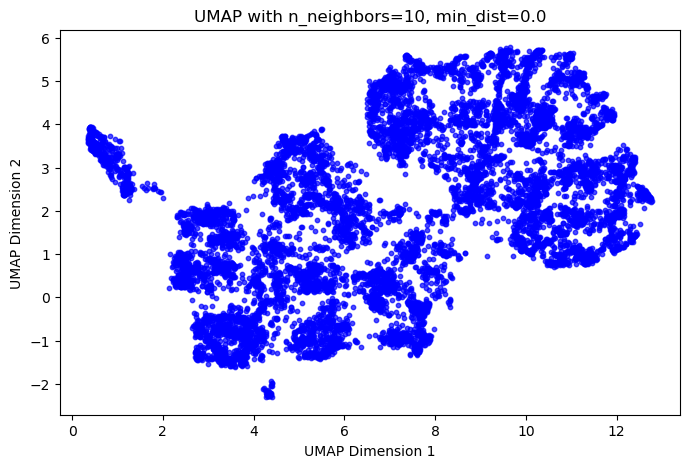

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


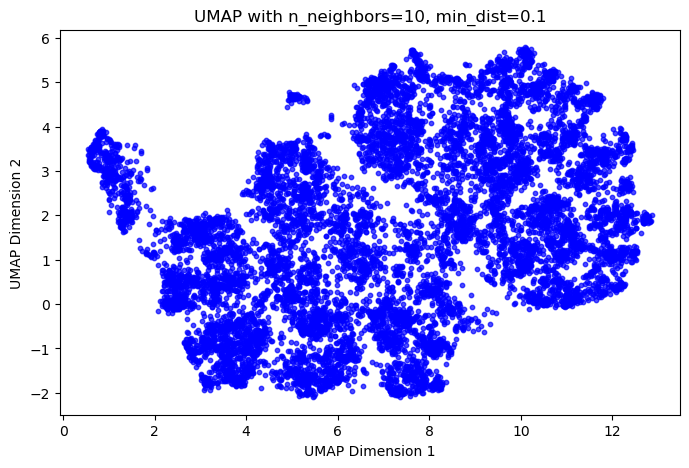

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


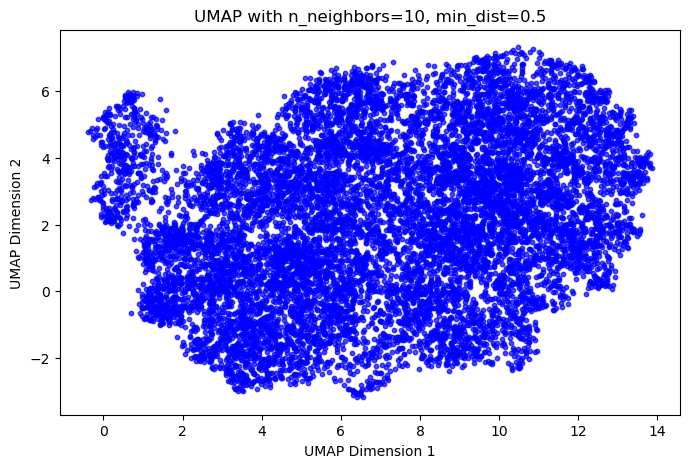

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


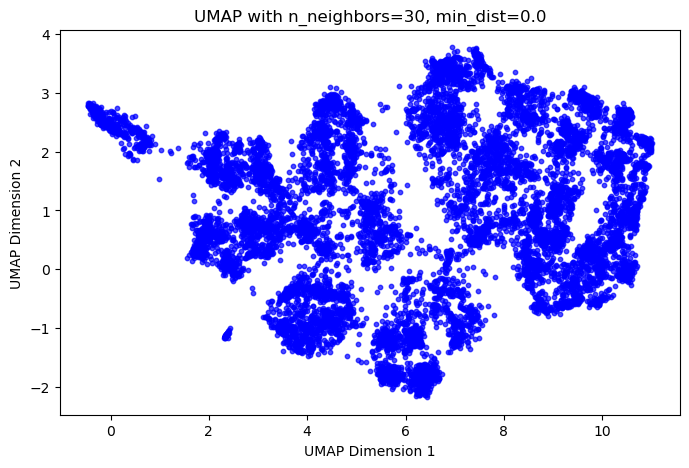

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


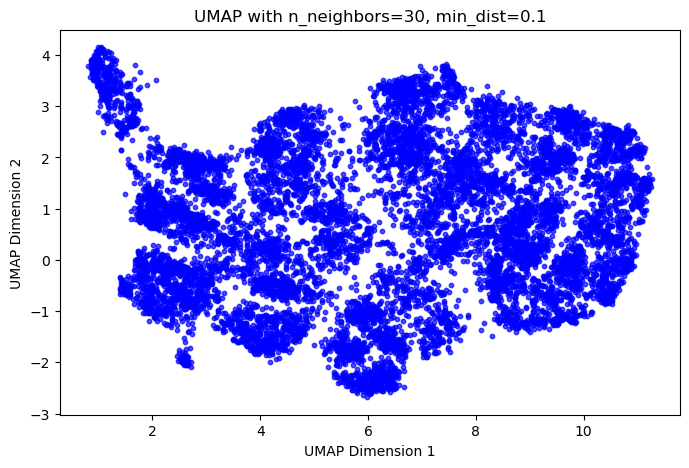

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


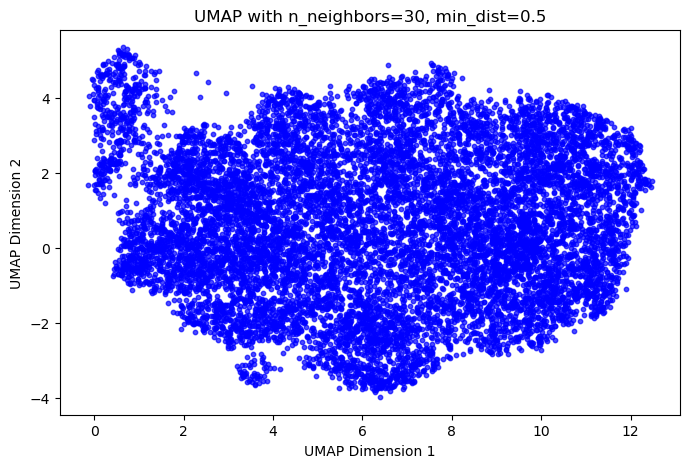

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


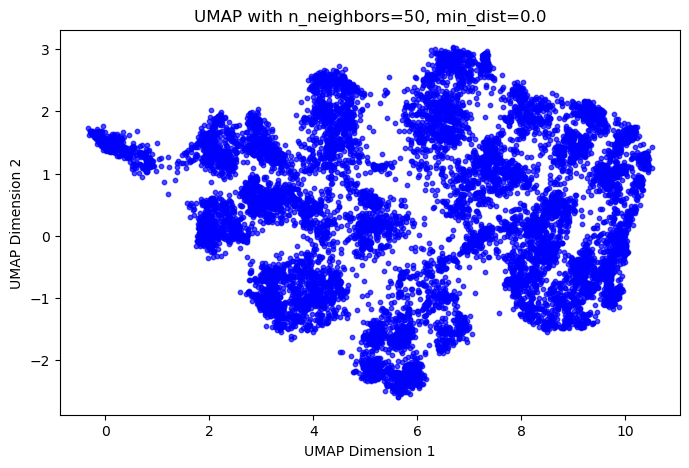

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


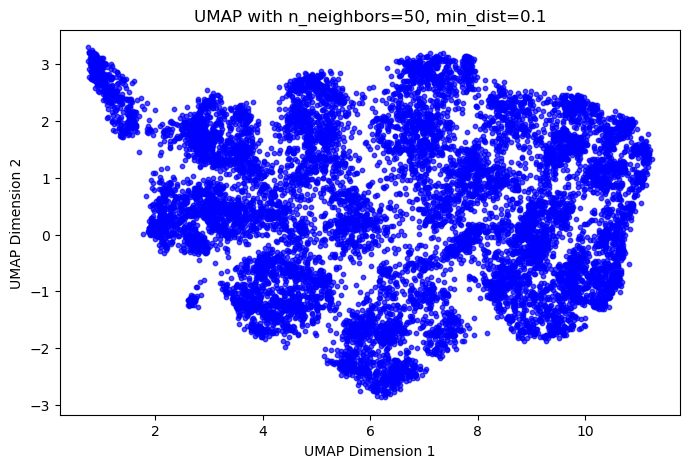

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


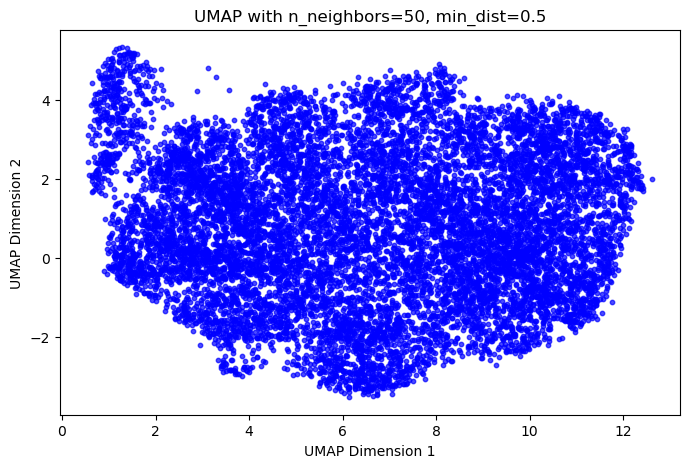

In [128]:
# Parameter tuning 
# Define parameter grids for n_neighbors and min_dist
n_neighbors_values = [10, 30, 50] 
min_dist_values = [0.0, 0.1, 0.5] 

# Store results for visualization
results_gower = {}

# Loop through combinations of parameters
for n_neighbors in n_neighbors_values:
    for min_dist in min_dist_values:
        # Apply UMAP with current parameters
        umap_model = umap.UMAP(
            n_neighbors=n_neighbors,
            min_dist=min_dist,
            n_components=2,
            metric='precomputed',
            random_state=42
        )
        umap_embeddings = umap_model.fit_transform(gower_dist_matrix)
        
        # Save the embeddings for later visualization
        results_gower[(n_neighbors, min_dist)] = umap_embeddings

        # Plot the embeddings
        plt.figure(figsize=(8, 5))
        plt.scatter(umap_embeddings[:, 0], umap_embeddings[:, 1], s=10, alpha=0.7, c='blue')
        plt.title(f'UMAP with n_neighbors={n_neighbors}, min_dist={min_dist}')
        plt.xlabel('UMAP Dimension 1')
        plt.ylabel('UMAP Dimension 2')
        plt.show()


In [129]:
# Apply UMAP to the Gower distance matrix using selected parameters
umap_embeddings_gower = umap.UMAP(n_neighbors=30, min_dist=0.1, n_components=2, metric='precomputed', random_state=42).fit_transform(gower_dist_matrix)


/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


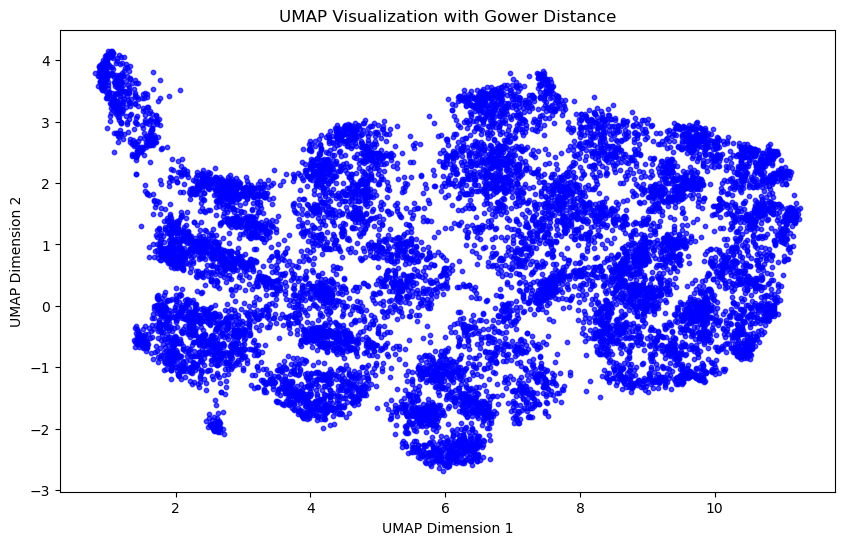

In [130]:
# Visualize the first two dimensions
plt.figure(figsize=(10, 6))
plt.scatter(umap_embeddings_gower[:, 0], umap_embeddings_gower[:, 1], s=10, alpha=0.7, c='blue')  
plt.title('UMAP Visualization with Gower Distance')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.show()

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1865: UserWarning: using precomputed metric; inverse_transform will be unavailable
  warn("using precomputed metric; inverse_transform will be unavailable")
/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


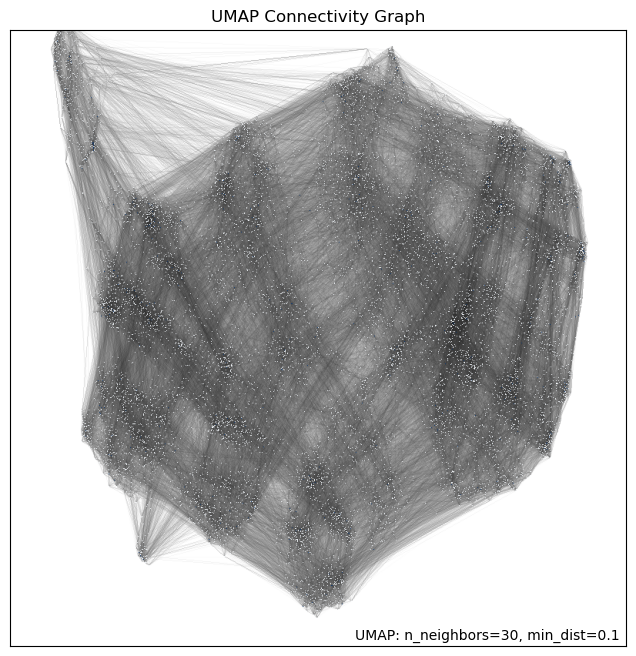

In [131]:
# Fit UMAP model on the Gower distance matrix
umap_model_connectivity = umap.UMAP(
    n_neighbors=30,
    min_dist=0.1,
    n_components=2,
    metric='precomputed',
    random_state=42
).fit(gower_dist_matrix)

# Plot the connectivity graph
umap.plot.connectivity(umap_model_connectivity, show_points=True)

# Show the plot
plt.title('UMAP Connectivity Graph')
plt.show()


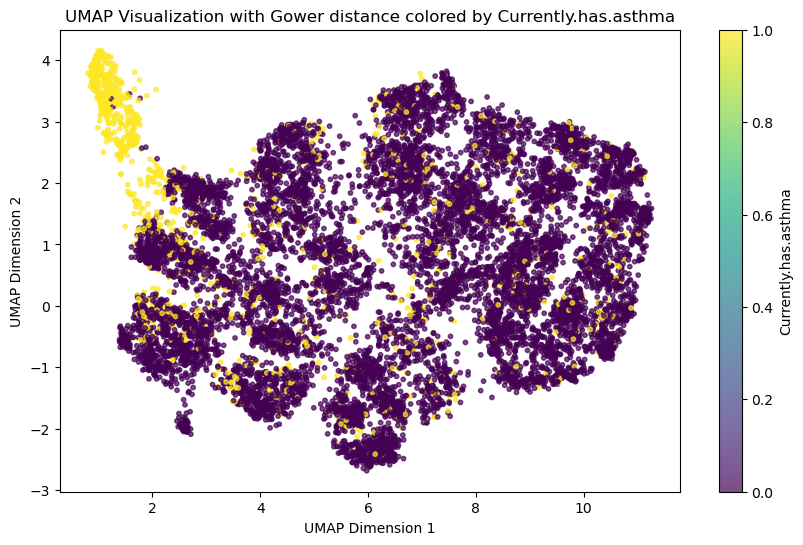

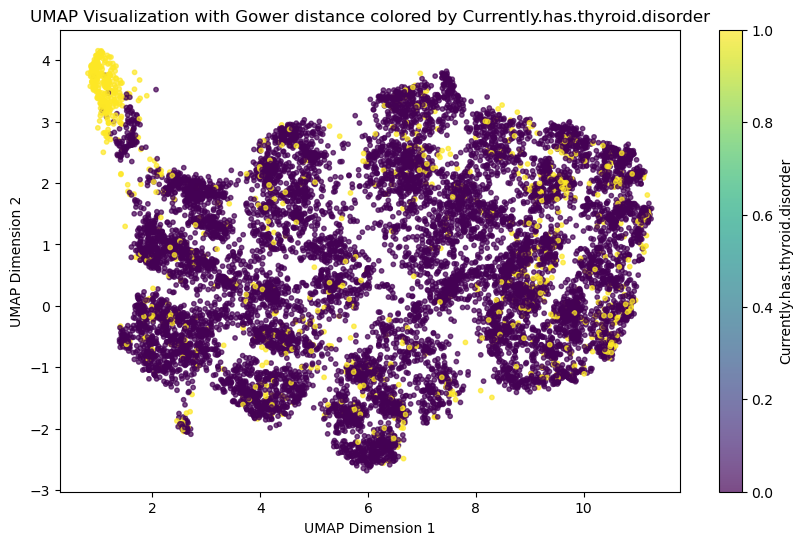

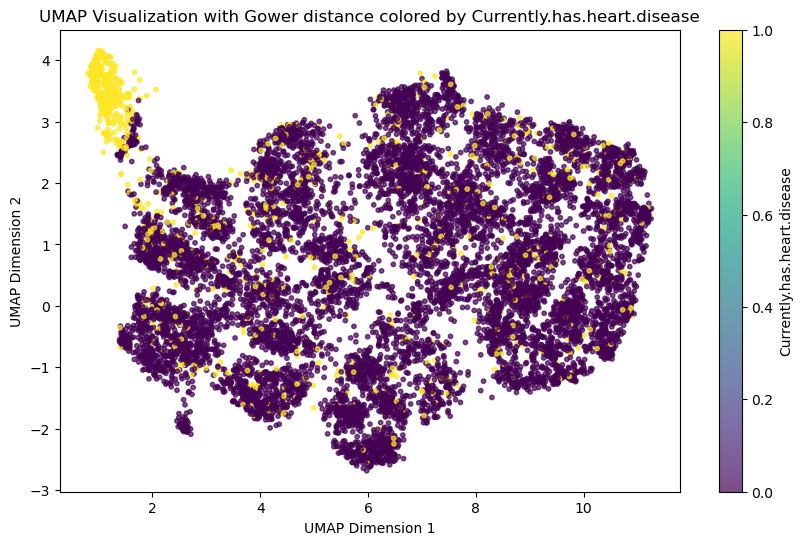

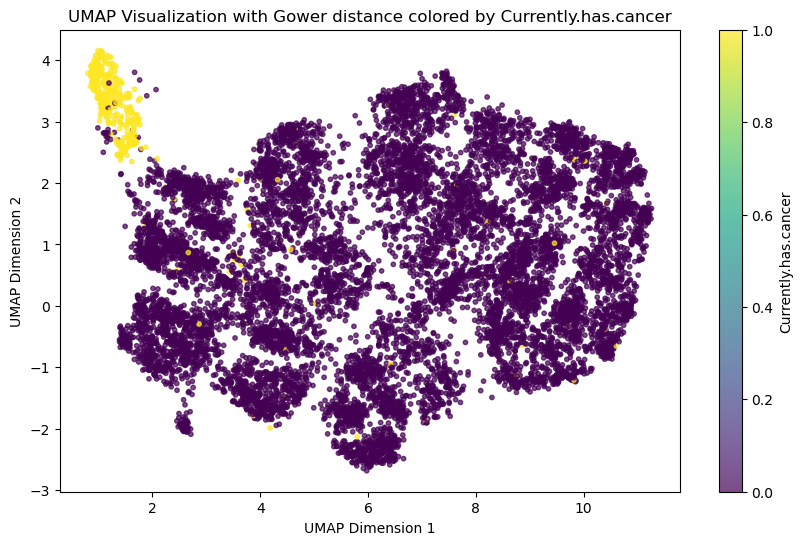

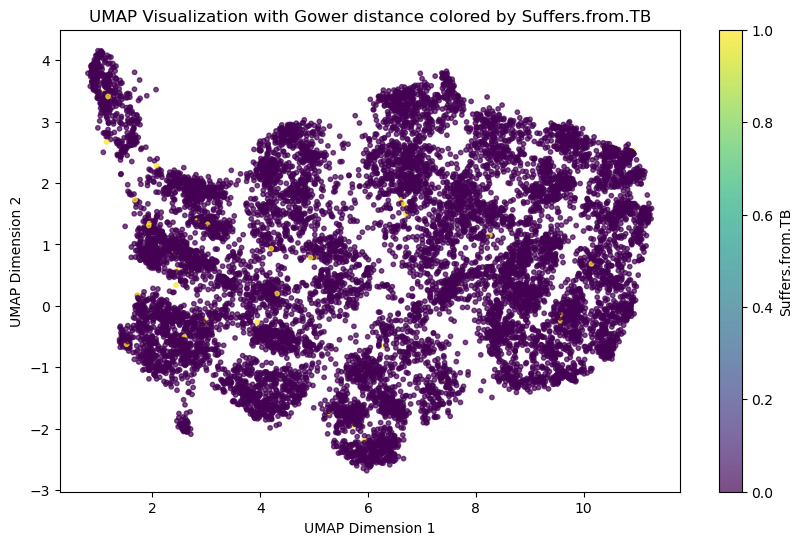

...

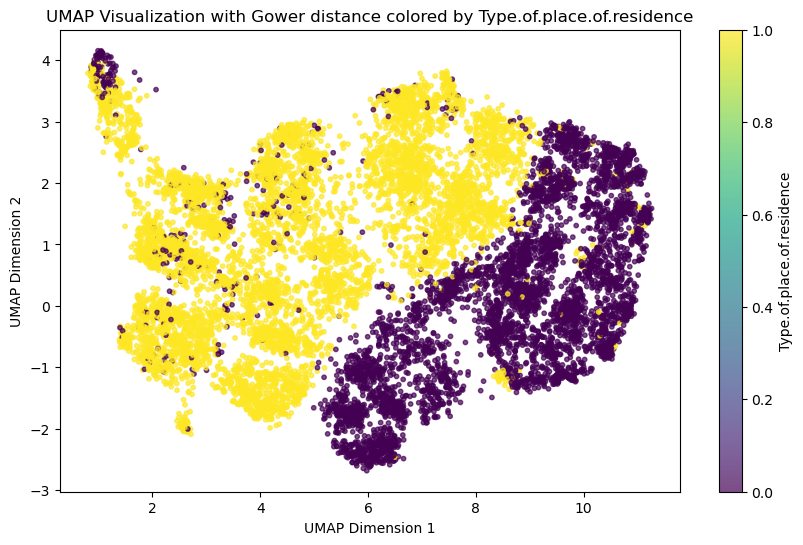

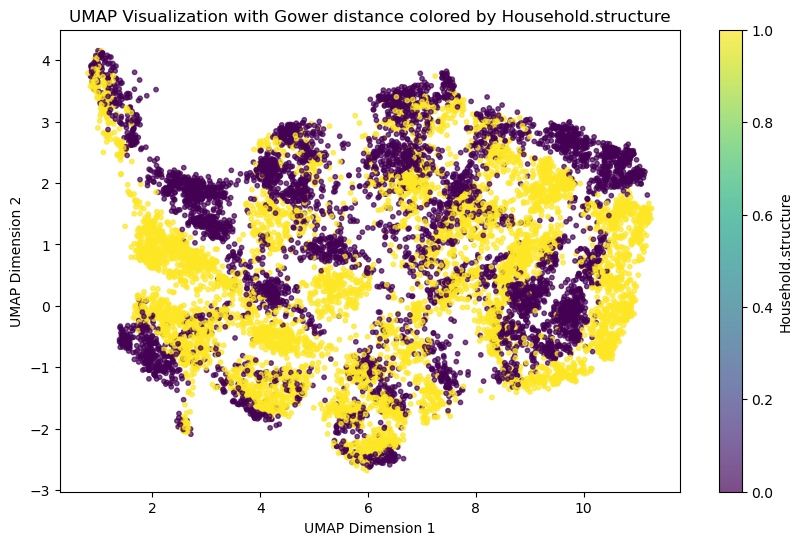

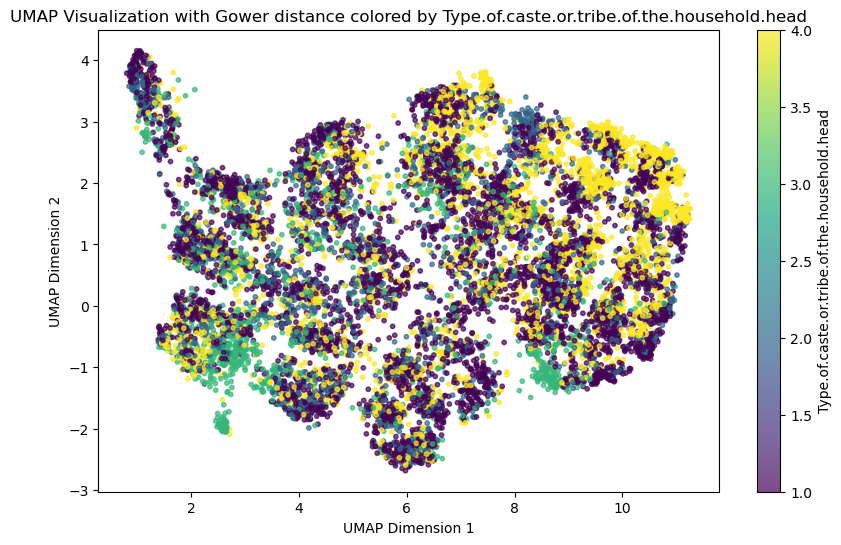

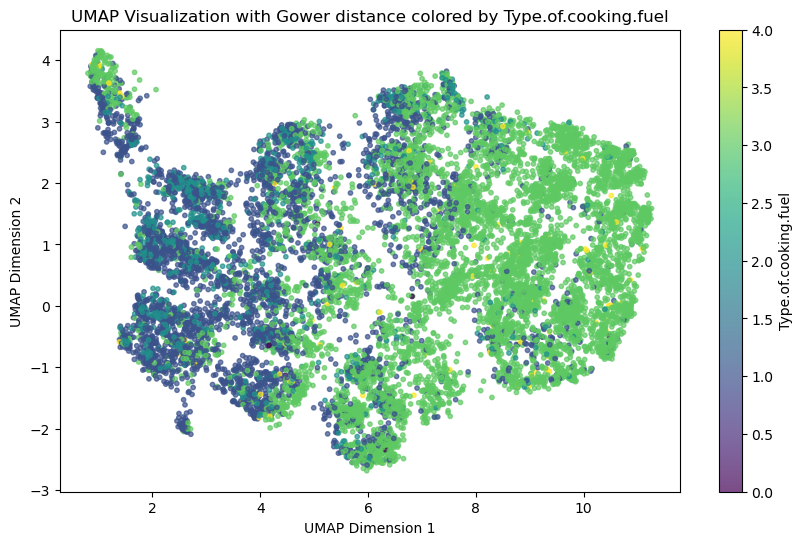

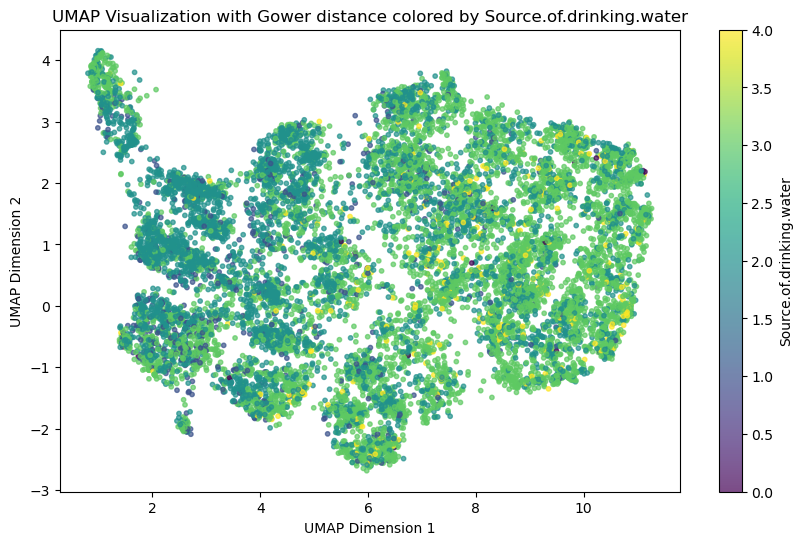

In [132]:
# Loop through each variable to create a separate plot
for variable in data_all:
    plt.figure(figsize=(10, 6))
    plt.scatter(
        umap_embeddings_gower[:, 0], 
        umap_embeddings_gower[:, 1], 
        c=data_all[variable],  # Color by the current variable
        cmap='viridis',  # Use a color map (e.g., 'viridis', 'plasma', 'coolwarm')
        s=10, 
        alpha=0.7
    )
    plt.title(f'UMAP Visualization with Gower distance colored by {variable}')
    plt.xlabel('UMAP Dimension 1')
    plt.ylabel('UMAP Dimension 2')
    plt.colorbar(label=variable)  # Add a colorbar for the variable
    plt.show()


## 3.2 Use Euclidean distance on all variables

/Users/zenghui/anaconda3/lib/python3.11/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


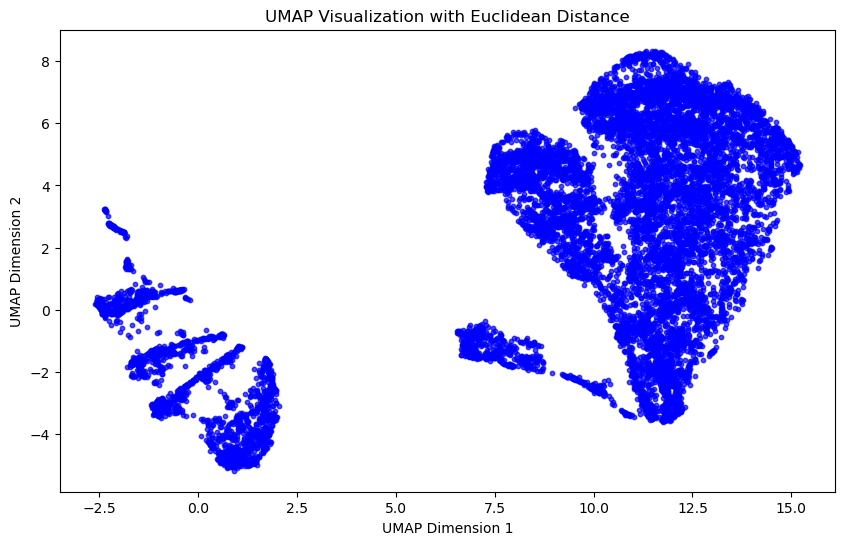

In [133]:
# Apply UMAP with Euclidean distance on all variables
umap_embeddings_euclidean_all = umap.UMAP(n_neighbors=30, min_dist=0.1, n_components=2, metric='euclidean', random_state=42).fit_transform(data_all)

# Visualize the first two dimensions
plt.figure(figsize=(10, 6))
plt.scatter(umap_embeddings_euclidean_all[:, 0], umap_embeddings_euclidean_all[:, 1], s=10, alpha=0.7, c='blue')
plt.title('UMAP Visualization with Euclidean Distance')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.show()


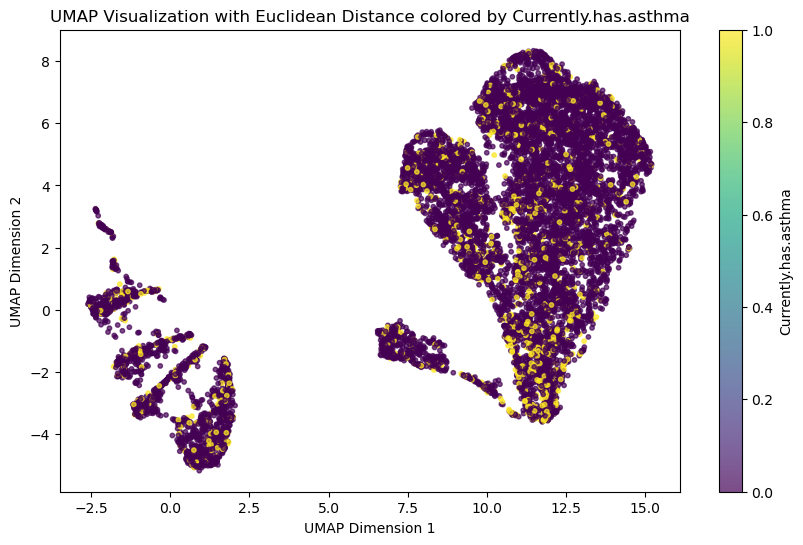

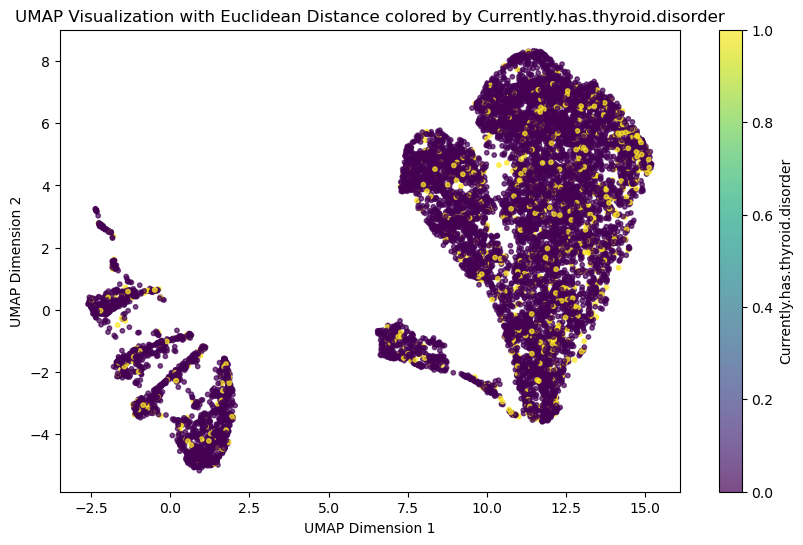

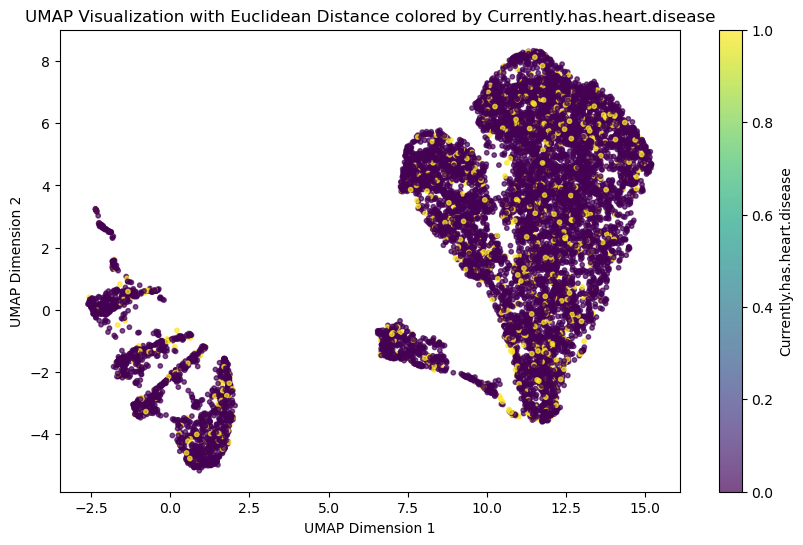

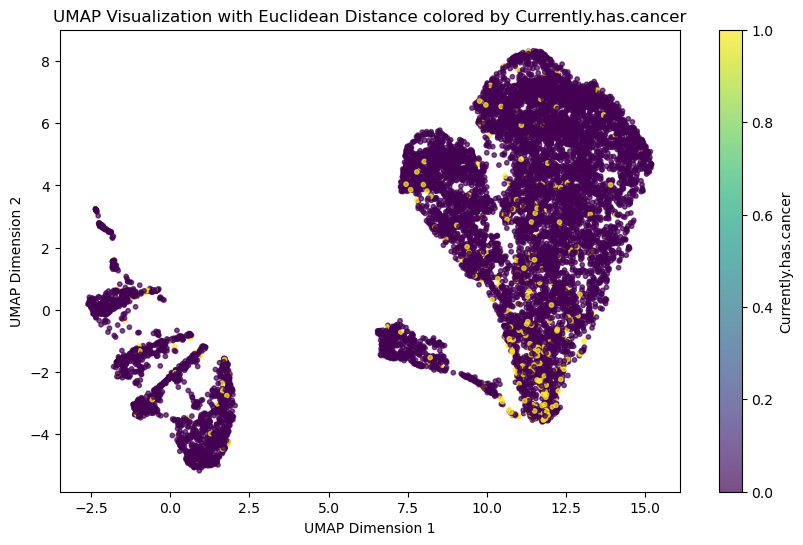

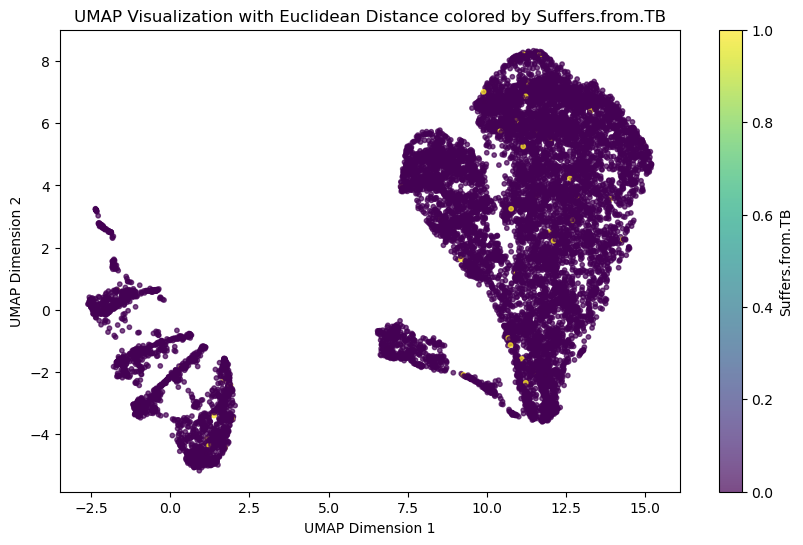

...

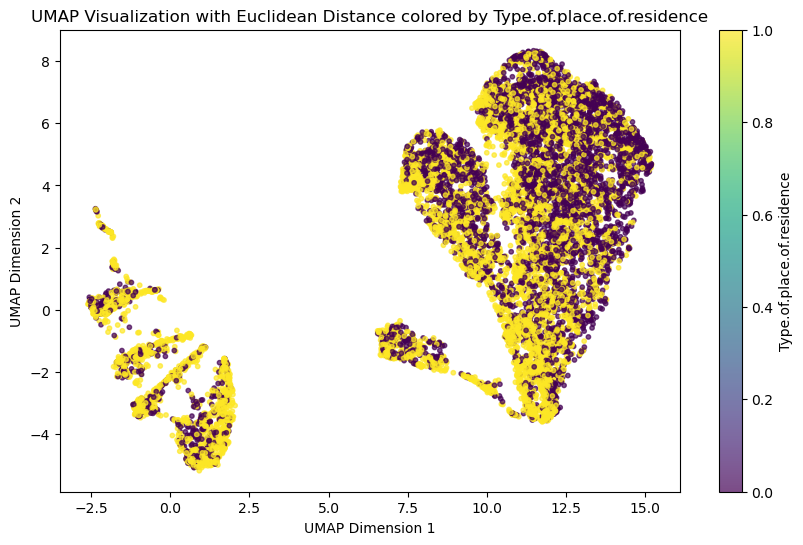

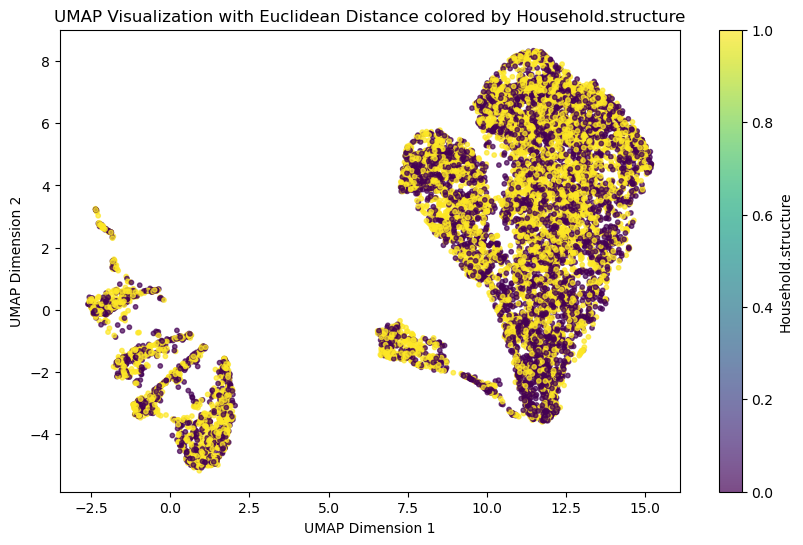

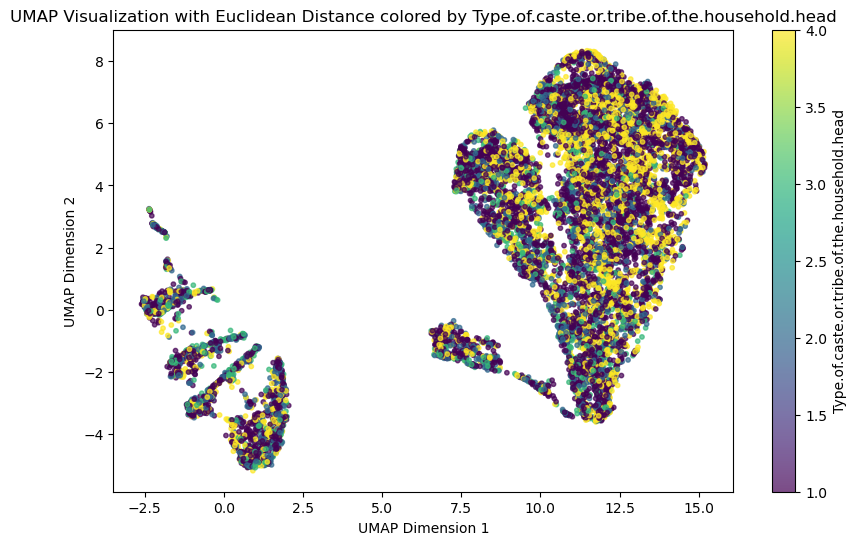

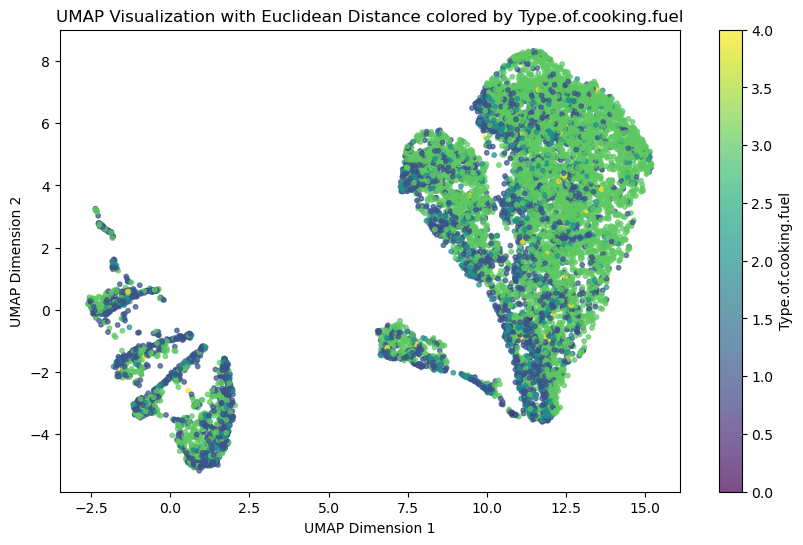

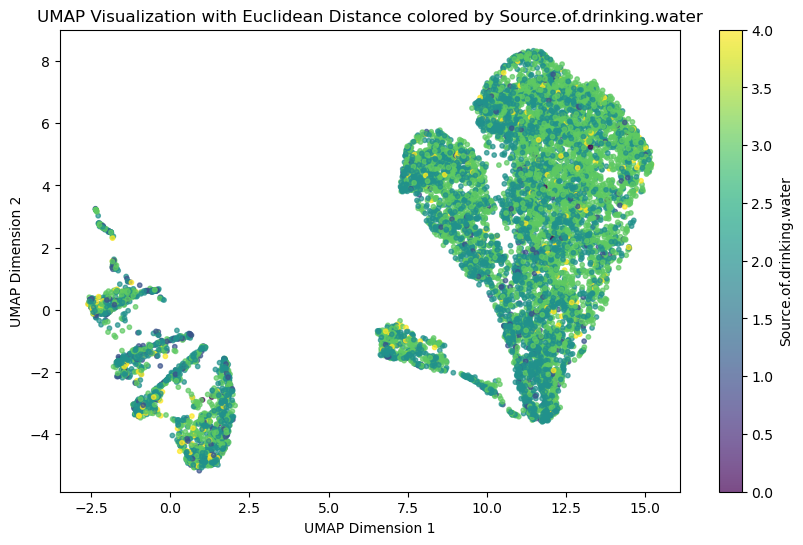

In [134]:
# Iterate through each continual variable in data_all for visualization
for variable in data_all:
    plt.figure(figsize=(10, 6))
    plt.scatter(
        umap_embeddings_euclidean_all[:, 0],  # UMAP Dimension 1
        umap_embeddings_euclidean_all[:, 1],  # UMAP Dimension 2
        c=data_all[variable],  # Color points by the current variable
        cmap='viridis',  # Use a color map for better visual contrast
        s=10,  # Point size
        alpha=0.7  # Transparency of points
    )
    plt.colorbar(label=variable)  # Add colorbar with the variable name
    plt.title(f'UMAP Visualization with Euclidean Distance colored by {variable}')
    plt.xlabel('UMAP Dimension 1')
    plt.ylabel('UMAP Dimension 2')
    plt.show()


# 4 UMAP enhanced HDBSCAN

## 4.1 HDBSCAN

Running HDBSCAN with min_cluster_size=10, min_samples=10


/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 880
Proportion of labeled points: 7.30%


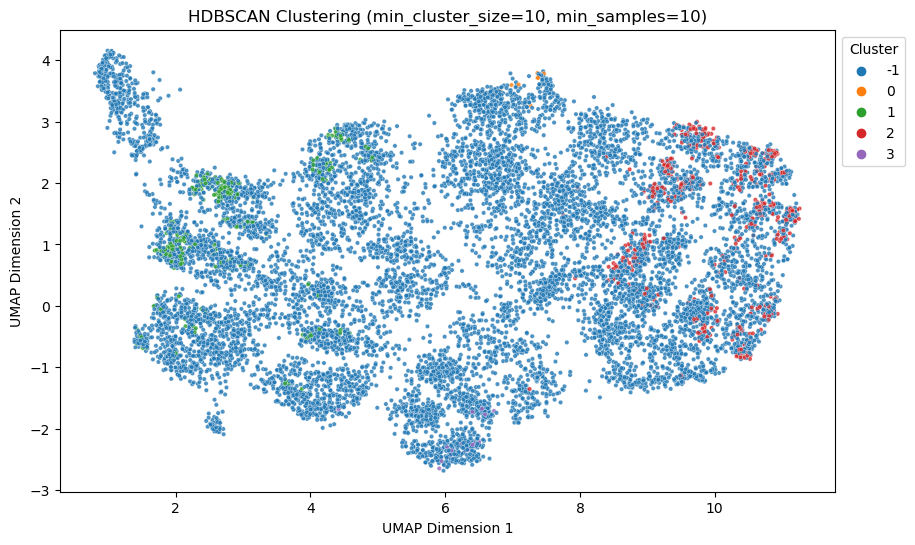

Running HDBSCAN with min_cluster_size=10, min_samples=50


/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 844
Proportion of labeled points: 7.00%


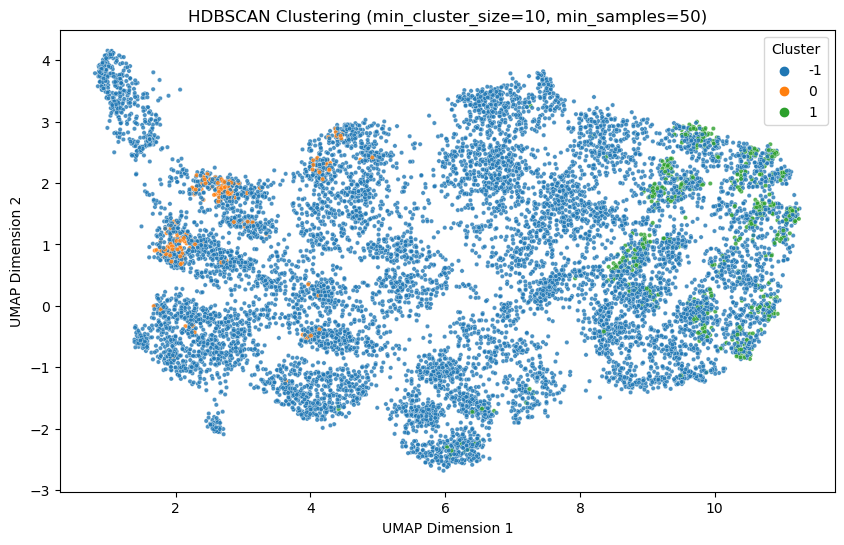

Running HDBSCAN with min_cluster_size=10, min_samples=100


/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 813
Proportion of labeled points: 6.74%


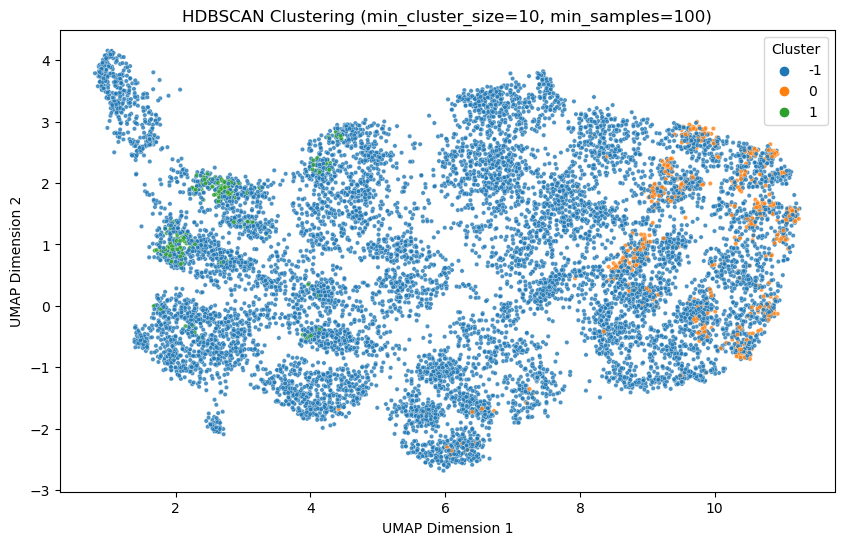

Running HDBSCAN with min_cluster_size=50, min_samples=10


/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 1200
Proportion of labeled points: 9.95%


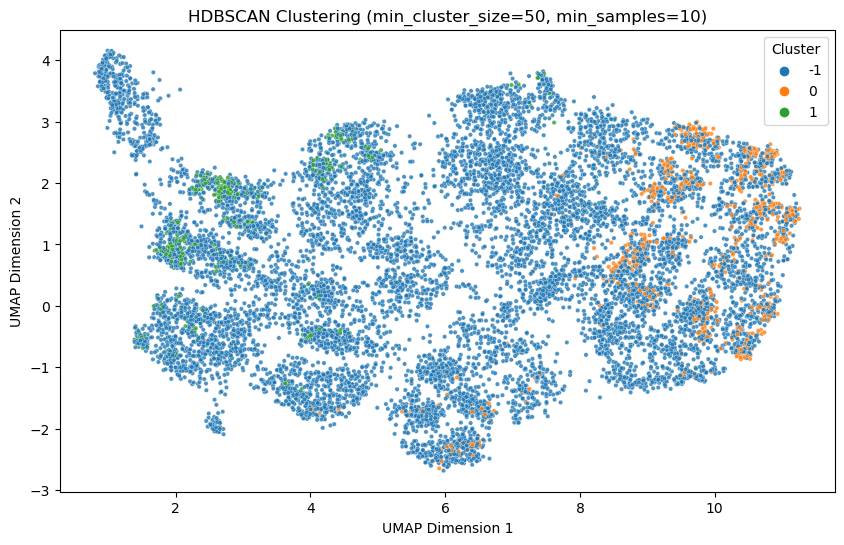

Running HDBSCAN with min_cluster_size=50, min_samples=50


/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 844
Proportion of labeled points: 7.00%


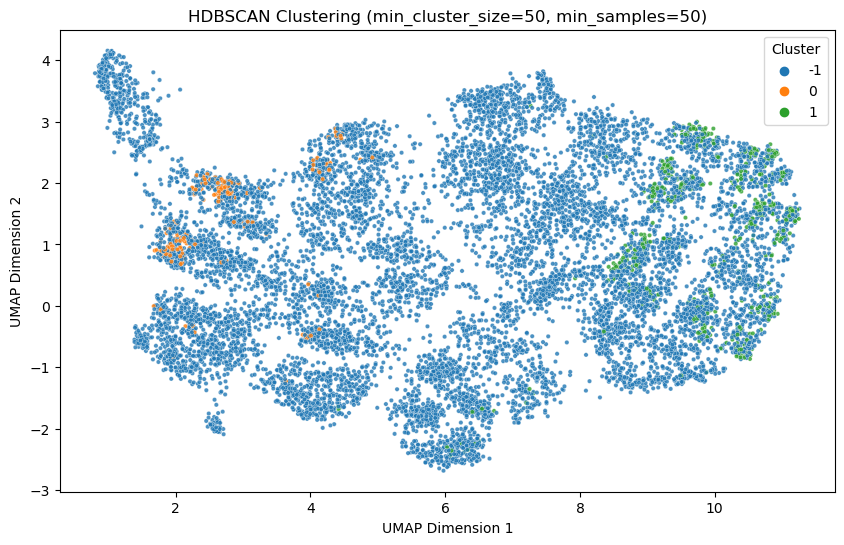

Running HDBSCAN with min_cluster_size=50, min_samples=100


/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 813
Proportion of labeled points: 6.74%


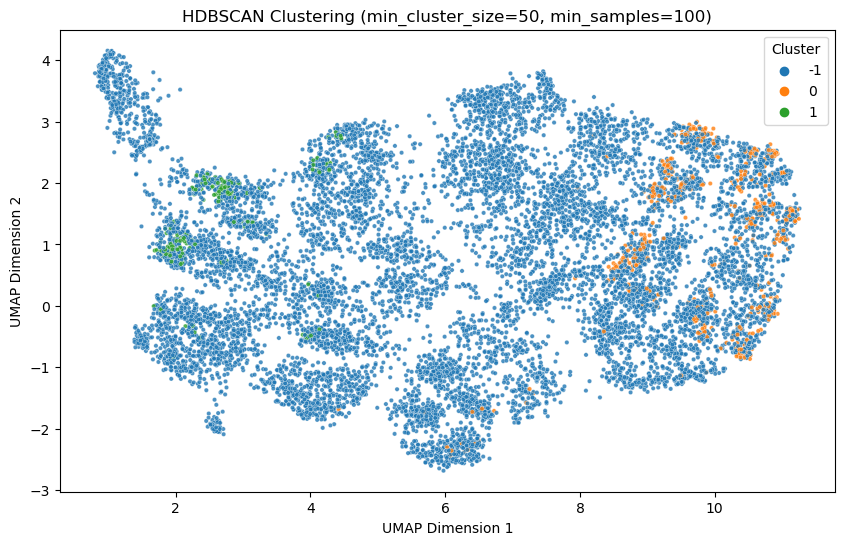

Running HDBSCAN with min_cluster_size=100, min_samples=10


/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 1200
Proportion of labeled points: 9.95%


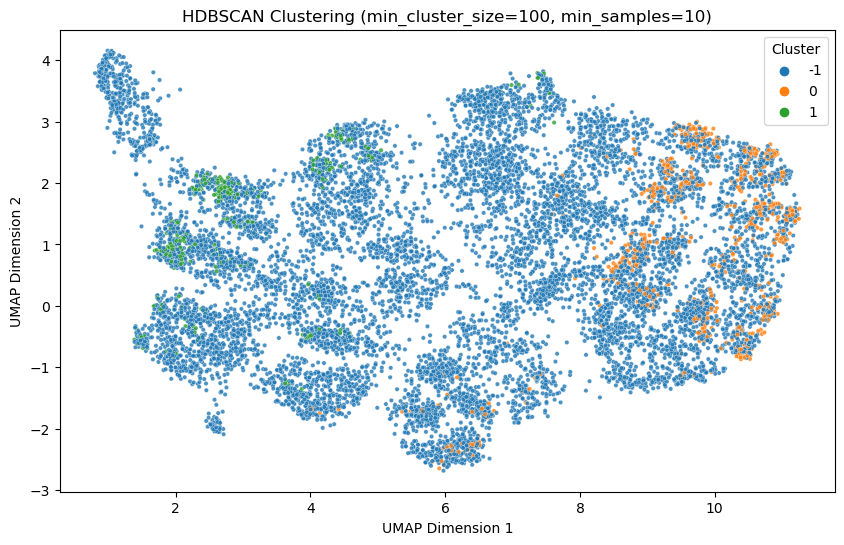

Running HDBSCAN with min_cluster_size=100, min_samples=50


/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 844
Proportion of labeled points: 7.00%


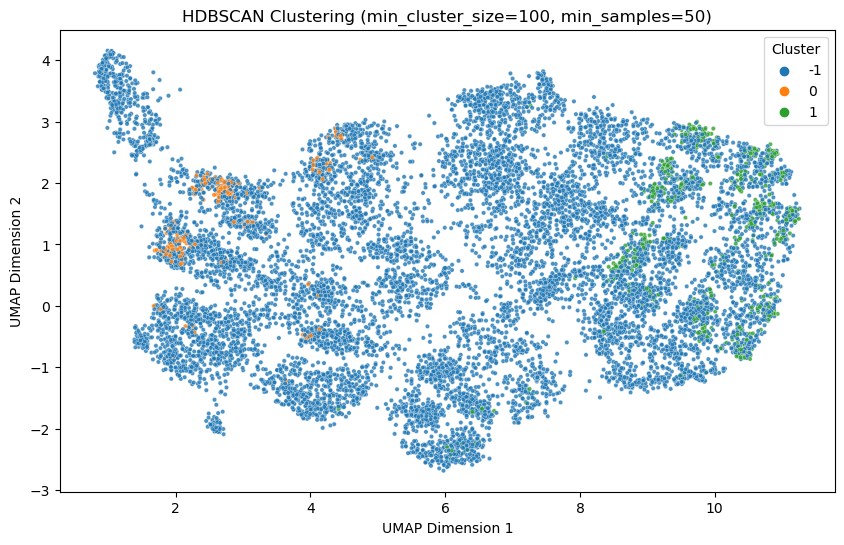

Running HDBSCAN with min_cluster_size=100, min_samples=100


/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 813
Proportion of labeled points: 6.74%


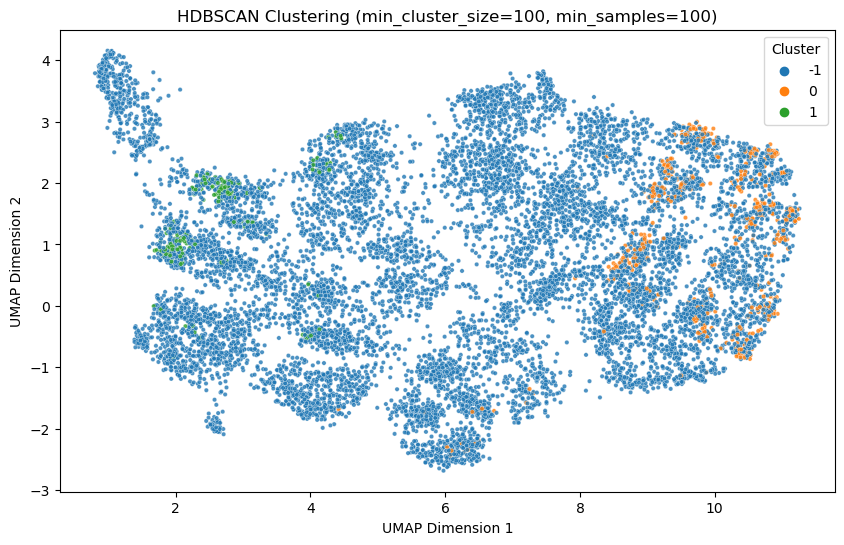

In [135]:
# Ensure the distance matrix is a NumPy array with dtype float64
gower_dist_matrix = np.array(gower_dist_matrix, dtype=np.float64)

# Define parameter grids for min_cluster_size and min_samples
min_cluster_size_values = [10, 50, 100]  # Minimum cluster size values to test
min_samples_values = [10, 50, 100]      # Minimum samples in neighborhood values to test


# Store clustering results for visualization
hdbscan_results = {}

# Loop through combinations of parameters
for min_cluster_size in min_cluster_size_values:
    for min_samples in min_samples_values:
        print(f"Running HDBSCAN with min_cluster_size={min_cluster_size}, min_samples={min_samples}")
        
        # Apply HDBSCAN clustering with current parameters
        hdbscan_clusterer = hdbscan.HDBSCAN(
            min_cluster_size=min_cluster_size,  # Minimum cluster size
            min_samples=min_samples,           # Minimum samples in a neighborhood
            metric='precomputed',              # Use precomputed Gower distance matrix
            cluster_selection_method='eom',    # Method for cluster selection
            prediction_data=True               # Enable prediction for new data points
        )
        
        # Fit and predict cluster labels
        hdbscan_labels = hdbscan_clusterer.fit_predict(gower_dist_matrix)
        
        # Save results for later visualization
        hdbscan_results[(min_cluster_size, min_samples)] = hdbscan_labels
        
        # Calculate the proportion of points with a label (not noise)
        total_points = len(hdbscan_labels)  # Total number of points
        labeled_points = np.sum(hdbscan_labels != -1)  # Points with a valid label (not noise)
        labeled_ratio = labeled_points / total_points  # Proportion of labeled points
        
        # Print the result
        print(f"Total points: {total_points}")
        print(f"Labeled points (not noise): {labeled_points}")
        print(f"Proportion of labeled points: {labeled_ratio:.2%}")
        
        # Visualize the clustering results
        plt.figure(figsize=(10, 6))
        sns.scatterplot(
            x=umap_embeddings_gower[:, 0],
            y=umap_embeddings_gower[:, 1],
            hue=hdbscan_labels,                # Color by cluster labels
            palette='tab10',                   # Use tab10 color palette
            s=10, alpha=0.8,                   # Adjust point size and transparency
            legend='full'                      # Display full legend
        )
        plt.title(f'HDBSCAN Clustering (min_cluster_size={min_cluster_size}, min_samples={min_samples})')
        plt.xlabel('UMAP Dimension 1')
        plt.ylabel('UMAP Dimension 2')
        plt.legend(title='Cluster', loc='best', bbox_to_anchor=(1, 1))
        plt.show()



/Users/zenghui/anaconda3/lib/python3.11/site-packages/hdbscan/hdbscan_.py:1320: UserWarning: Cannot generate prediction data for non-vectorspace inputs -- access to the source data ratherthan mere distances is required!
  warn(


Total points: 12062
Labeled points (not noise): 1200
Proportion of labeled points: 9.95%


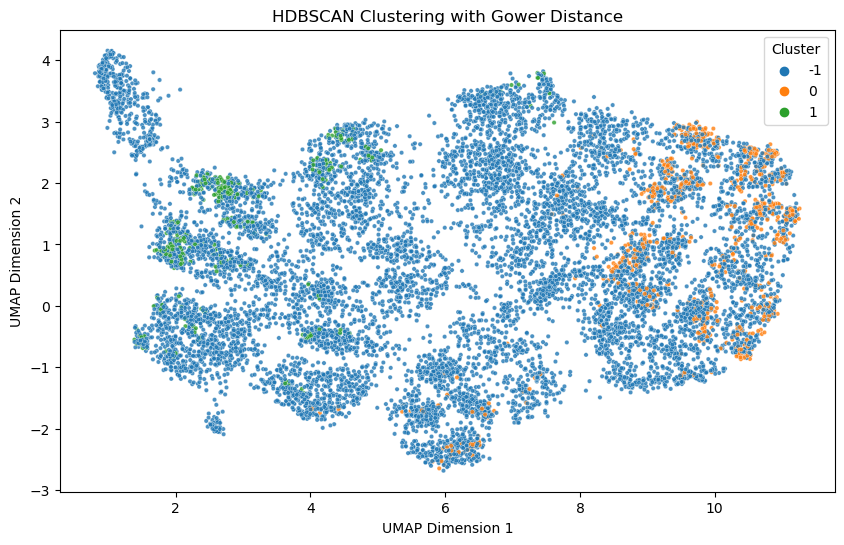

HDBSCAN Cluster Labels: [-1 -1 -1 ... -1 -1 -1]


In [136]:
# Ensure the distance matrix is a NumPy array with dtype float64
gower_dist_matrix = np.array(gower_dist_matrix, dtype=np.float64)

# Apply HDBSCAN clustering using Gower distance
hdbscan_clusterer = hdbscan.HDBSCAN(
    min_cluster_size=50,       # Minimum cluster size
    min_samples=10,             # Minimum samples in a neighborhood
    metric='precomputed',      # Use precomputed distance matrix (Gower distance)
    cluster_selection_method='eom',  # Method for cluster selection
    prediction_data=True       # Enable prediction for new data points
)

# Fit HDBSCAN on the precomputed Gower distance matrix
hdbscan_labels = hdbscan_clusterer.fit_predict(gower_dist_matrix)

# Calculate the proportion of points with a label (not noise)
total_points = len(hdbscan_labels)  # Total number of points
labeled_points = np.sum(hdbscan_labels != -1)  # Points with a valid label (not noise)
labeled_ratio = labeled_points / total_points  # Proportion of labeled points

# Print the result
print(f"Total points: {total_points}")
print(f"Labeled points (not noise): {labeled_points}")
print(f"Proportion of labeled points: {labeled_ratio:.2%}")

# Visualize the clustering results
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=umap_embeddings_gower[:, 0],
    y=umap_embeddings_gower[:, 1],
    hue=hdbscan_labels,
    palette='tab10',
    s=10, alpha=0.8,
    legend='full'
)
plt.title('HDBSCAN Clustering with Gower Distance')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.legend(title='Cluster', loc='best', bbox_to_anchor=(1, 1))
plt.show()

# Print cluster labels and noise points (-1 indicates noise)
print("HDBSCAN Cluster Labels:", hdbscan_labels)


## 4.2 UMAP enhanced HDBSCAN


Running HDBSCAN with min_cluster_size=5, min_samples=50
Total points: 12062
Labeled points (not noise): 8043
Proportion of labeled points: 66.68%


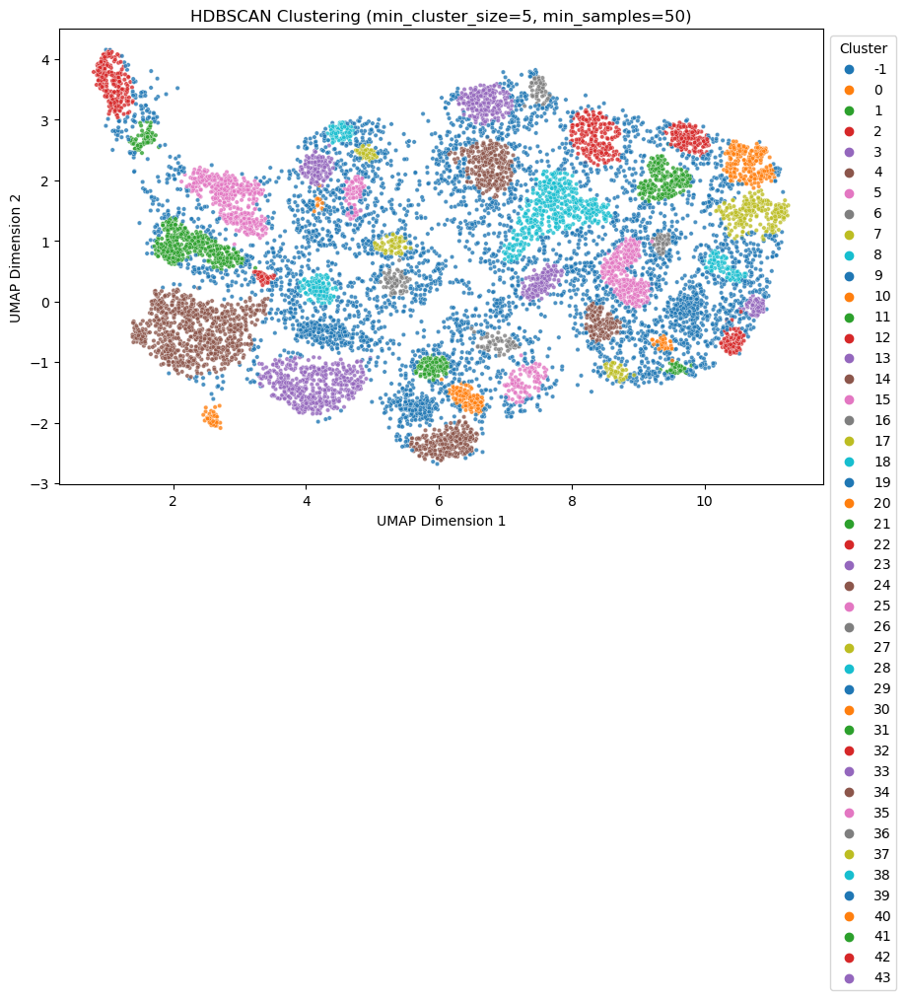

Running HDBSCAN with min_cluster_size=5, min_samples=100
Total points: 12062
Labeled points (not noise): 10015
Proportion of labeled points: 83.03%


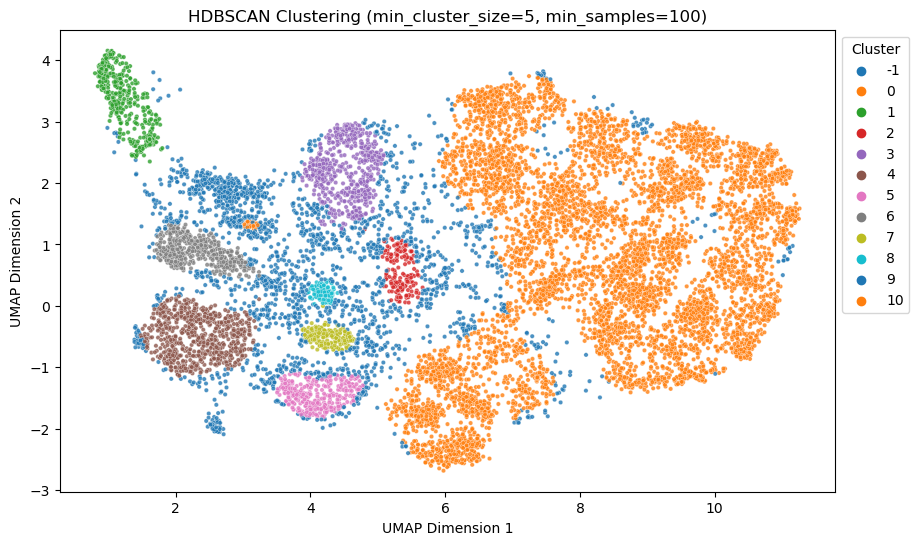

Running HDBSCAN with min_cluster_size=5, min_samples=500
Total points: 12062
Labeled points (not noise): 8671
Proportion of labeled points: 71.89%


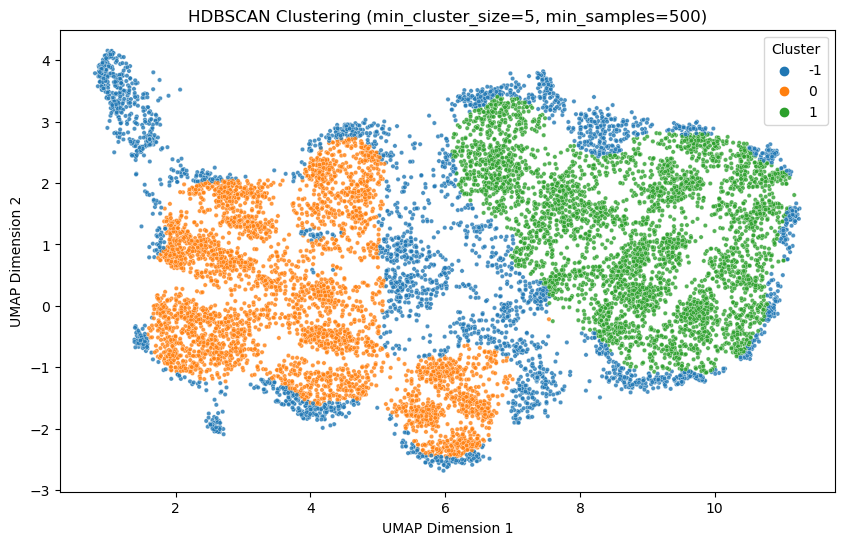

Running HDBSCAN with min_cluster_size=10, min_samples=50
Total points: 12062
Labeled points (not noise): 8043
Proportion of labeled points: 66.68%


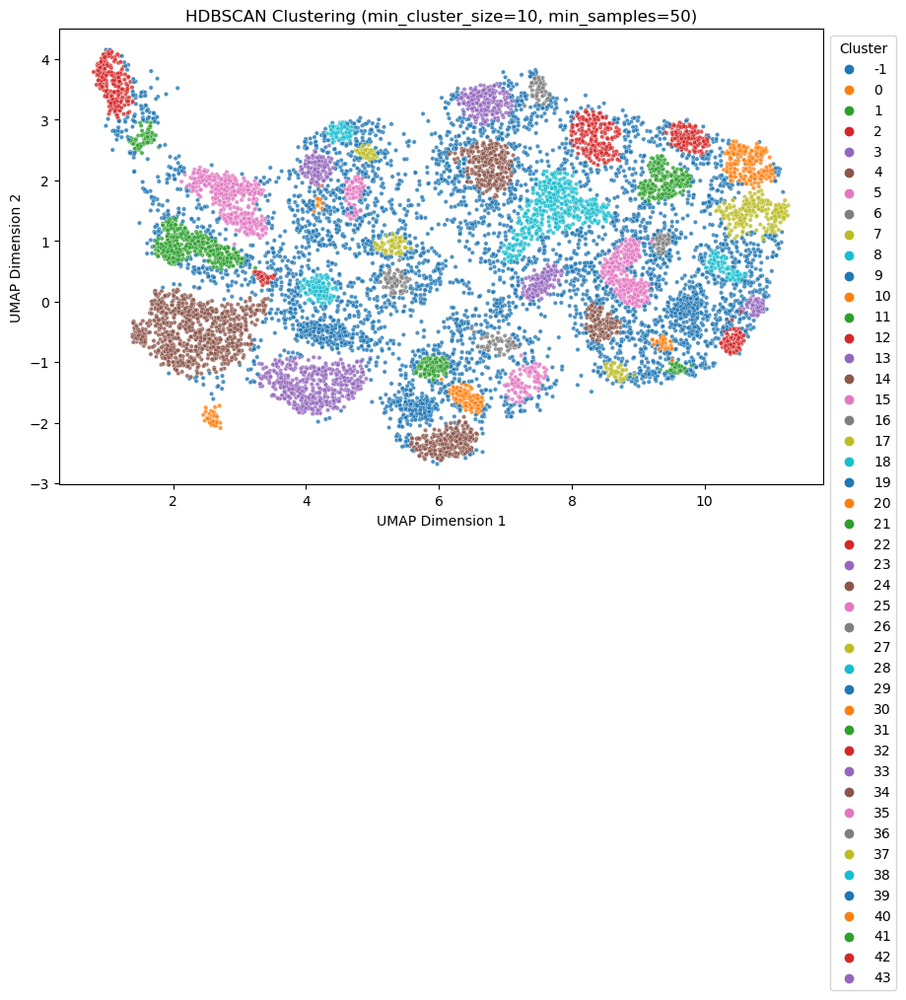

Running HDBSCAN with min_cluster_size=10, min_samples=100
Total points: 12062
Labeled points (not noise): 10015
Proportion of labeled points: 83.03%


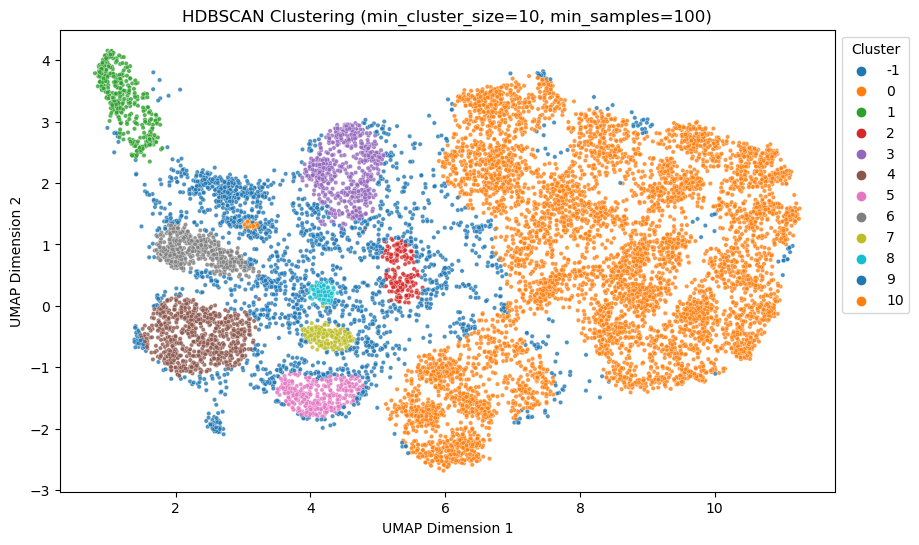

Running HDBSCAN with min_cluster_size=10, min_samples=500
Total points: 12062
Labeled points (not noise): 8671
Proportion of labeled points: 71.89%


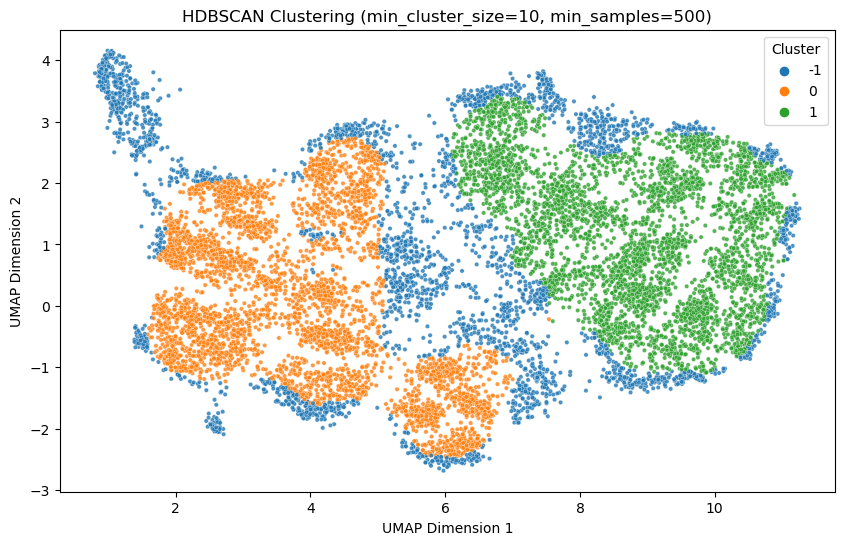

Running HDBSCAN with min_cluster_size=20, min_samples=50
Total points: 12062
Labeled points (not noise): 8192
Proportion of labeled points: 67.92%


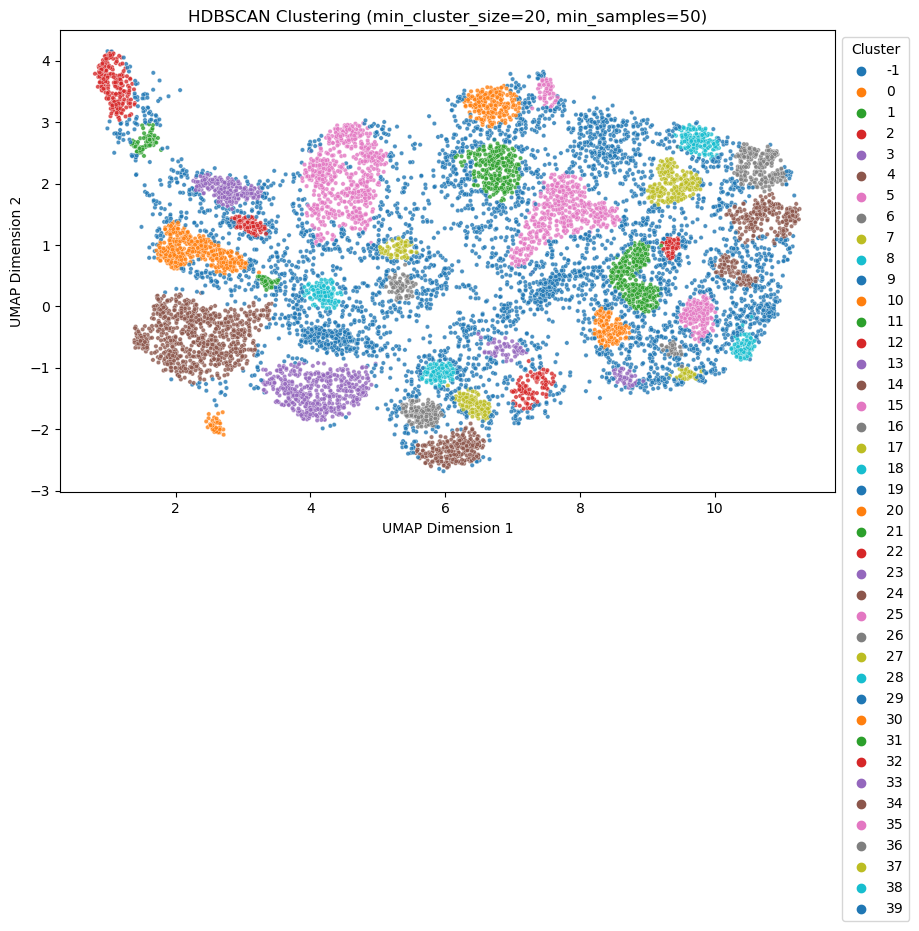

Running HDBSCAN with min_cluster_size=20, min_samples=100
Total points: 12062
Labeled points (not noise): 10015
Proportion of labeled points: 83.03%


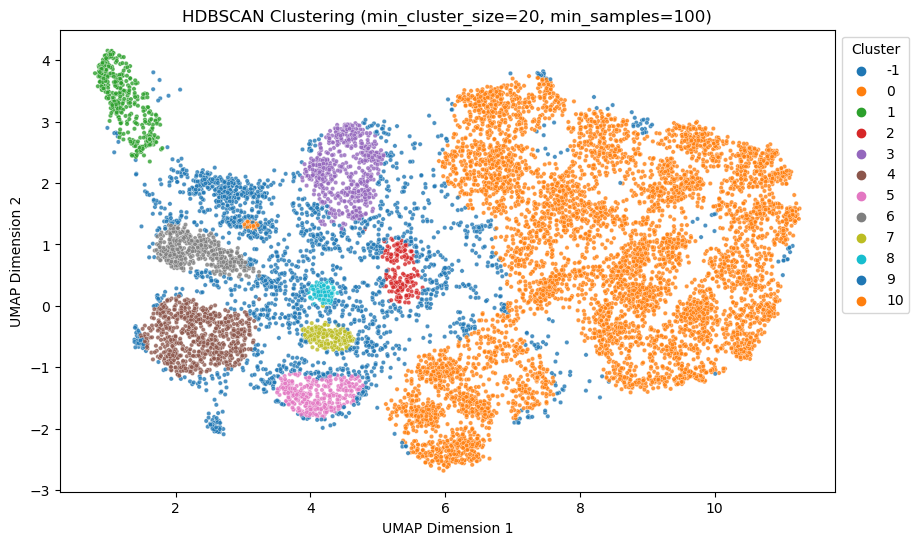

Running HDBSCAN with min_cluster_size=20, min_samples=500
Total points: 12062
Labeled points (not noise): 8671
Proportion of labeled points: 71.89%


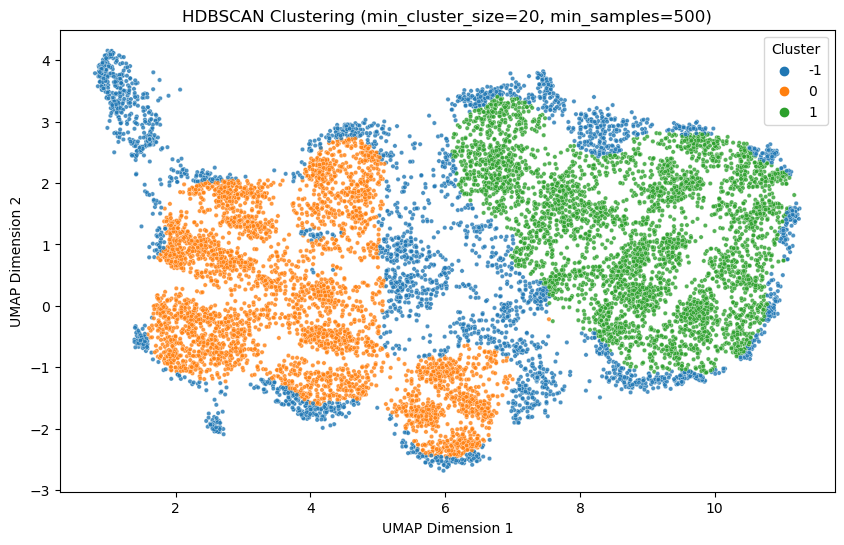

In [137]:
# Define parameter grids for min_cluster_size and min_samples
min_cluster_size_values = [5, 10, 20]  # Test different values for minimum cluster size
min_samples_values = [50, 100, 500]   # Test different values for minimum samples in a neighborhood


# Store clustering results for visualization
hdbscan_results_umap = {}

# Loop through combinations of parameters
for min_cluster_size in min_cluster_size_values:
    for min_samples in min_samples_values:
        print(f"Running HDBSCAN with min_cluster_size={min_cluster_size}, min_samples={min_samples}")
        
        # Apply HDBSCAN clustering with current parameters
        hdbscan_clusterer_umap = hdbscan.HDBSCAN(
            min_cluster_size=min_cluster_size,  # Minimum cluster size
            min_samples=min_samples,           # Minimum samples in a neighborhood
            metric='euclidean',                # Use Euclidean distance
            cluster_selection_method='eom',    # Method for cluster selection
            prediction_data=True               # Enable prediction for new data points
        )
        
        # Fit and predict cluster labels
        hdbscan_labels_umap = hdbscan_clusterer_umap.fit_predict(umap_embeddings_gower)
        
        # Save results for further analysis
        hdbscan_results_umap[(min_cluster_size, min_samples)] = hdbscan_labels_umap
        
        # Calculate the proportion of points with a label (not noise)
        total_points = len(hdbscan_labels_umap)  # Total number of points
        labeled_points = np.sum(hdbscan_labels_umap != -1)  # Points with a valid label (not noise)
        labeled_ratio = labeled_points / total_points  # Proportion of labeled points
        
        # Print the result
        print(f"Total points: {total_points}")
        print(f"Labeled points (not noise): {labeled_points}")
        print(f"Proportion of labeled points: {labeled_ratio:.2%}")
        
        # Visualize the clustering results
        plt.figure(figsize=(10, 6))
        sns.scatterplot(
            x=umap_embeddings_gower[:, 0],
            y=umap_embeddings_gower[:, 1],
            hue=hdbscan_labels_umap,
            palette='tab10',
            s=10, alpha=0.8,
            legend='full'
        )
        plt.title(f'HDBSCAN Clustering (min_cluster_size={min_cluster_size}, min_samples={min_samples})')
        plt.xlabel('UMAP Dimension 1')
        plt.ylabel('UMAP Dimension 2')
        plt.legend(title='Cluster', loc='best', bbox_to_anchor=(1, 1))
        plt.show()


Total points: 12062
Labeled points (not noise): 8671
Proportion of labeled points: 71.89%


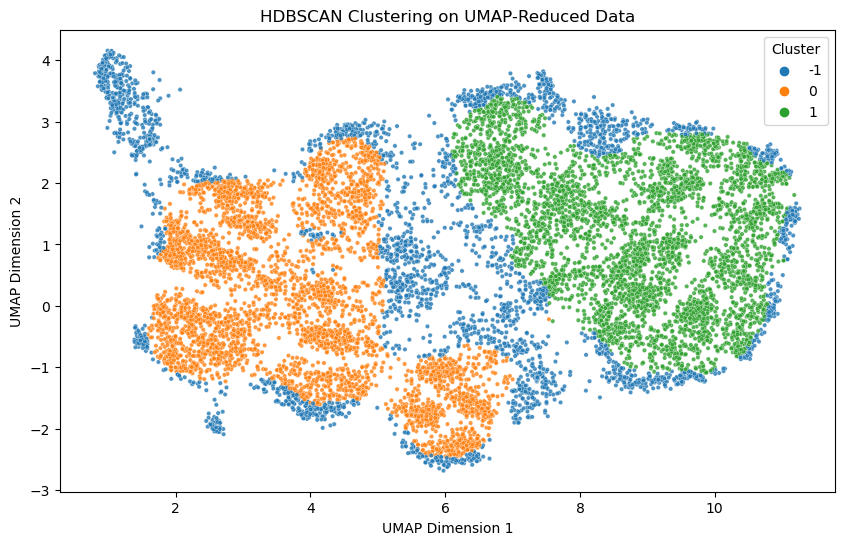

HDBSCAN Cluster Labels on UMAP Data: [ 1  1  1 ...  1  1 -1]


In [138]:
# Apply HDBSCAN on UMAP-reduced data
hdbscan_clusterer_umap = hdbscan.HDBSCAN(
    min_cluster_size=10,  # Minimum cluster size
    min_samples=500,      # Minimum samples in a neighborhood
    metric='euclidean',   # Default metric for low-dimensional data
    cluster_selection_method='eom',  # Method for cluster selection
    prediction_data=True  # Enable prediction for new data points
)

# Fit HDBSCAN on UMAP embeddings
hdbscan_labels_umap = hdbscan_clusterer_umap.fit_predict(umap_embeddings_gower)

# Calculate the proportion of points with a label (not noise)
total_points = len(hdbscan_labels_umap)  # Total number of points
labeled_points = np.sum(hdbscan_labels_umap != -1)  # Points with a valid label (not noise)
labeled_ratio = labeled_points / total_points  # Proportion of labeled points

# Print the result
print(f"Total points: {total_points}")
print(f"Labeled points (not noise): {labeled_points}")
print(f"Proportion of labeled points: {labeled_ratio:.2%}")

# Visualize the clustering results
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x=umap_embeddings_gower[:, 0],
    y=umap_embeddings_gower[:, 1],
    hue=hdbscan_labels_umap,
    palette='tab10',
    s=10, alpha=0.8,
    legend='full'
)
plt.title('HDBSCAN Clustering on UMAP-Reduced Data')
plt.xlabel('UMAP Dimension 1')
plt.ylabel('UMAP Dimension 2')
plt.legend(title='Cluster', loc='best', bbox_to_anchor=(1, 1))
plt.show()

# Print cluster labels
print("HDBSCAN Cluster Labels on UMAP Data:", hdbscan_labels_umap)


# 5 Topological data analysis

## 5.1 KNN networks

In [139]:
def create_knn_links(distance_matrix, k=5):
    """
    Generate KNN edges based on a distance matrix.
    :param distance_matrix: Precomputed distance matrix
    :param k: Number of nearest neighbors to connect
    :return: List of KNN edges
    """
    knn_links = []
    for i in range(len(distance_matrix)):
        dist_i = distance_matrix[i]
        # Sort distances and select the k nearest neighbors (excluding self)
        nearest_indices = np.argsort(dist_i)[1:k+1]
        for j in nearest_indices:
            knn_links.append([i, j, dist_i[j]])  # Create an edge with distance
    return knn_links


In [140]:
# Generate KNN edges for k=5
knn_links = create_knn_links(gower_dist_matrix, k=5)


In [141]:
# Save links and nodes
# Create a DataFrame for edges
knn_links_df = pd.DataFrame(knn_links, columns=['source', 'target', 'distance'])

# Export edges to a CSV file
knn_links_df.to_csv('knn_links.csv', index=False)

# Create nodes (with attributes) for Gephi visualization
# Include specified variables for coloring and other visual effects in Gephi
nodes_df = data_all[['Wealth.index', 'Type.of.place.of.residence', 
                     'Frequency.eats.fish', 'Frequency.eats.chicken.or.meat', 'Has.refrigerator']]
nodes_df['id'] = range(len(nodes_df))  # Generate unique IDs for each node

# Save nodes to a CSV file for Gephi visualization
nodes_df.to_csv('nodes_with_attributes.csv', index=False)

/var/folders/dr/0j9y6x3n3nv4s_4ssbwb3g240000gn/T/ipykernel_1407/527504886.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nodes_df['id'] = range(len(nodes_df))  # Generate unique IDs for each node


## 5.2 Multi-MST networks

In [ ]:
# Generate Multi-MST from Gower distance matrix
num_trees = 10  # Number of MSTs to combine
noise_fraction = 0.5  # Fraction of noise to add for each MST
projector = NoisyMST(num_trees=num_trees, noise_fraction=noise_fraction).fit(gower_dist_matrix)

# Extract edges from the combined MST
coo_matrix = projector.graph_.tocoo()
sources = coo_matrix.row  # Start node of each edge
targets = coo_matrix.col  # End node of each edge
weights = coo_matrix.data  # Edge weights (distances)

# Create a DataFrame for edges
edges_df = pd.DataFrame({
    'source': sources,
    'target': targets,
    'weight': weights
})

# Save edges to a CSV file for Gephi
edges_df.to_csv('multi_mst_edges.csv', index=False)
